In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

#import numpy as np # linear algebra
#import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
#for dirname, _, filenames in os.walk('/kaggle/input'):
 #   for filename in filenames:
  #      print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import os
import glob
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import random

from PIL import Image
import cv2

In [3]:
metadata_path = os.path.join('/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv')
metadata = pd.read_csv(metadata_path)
metadata.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [4]:
metadata.shape

(10015, 7)

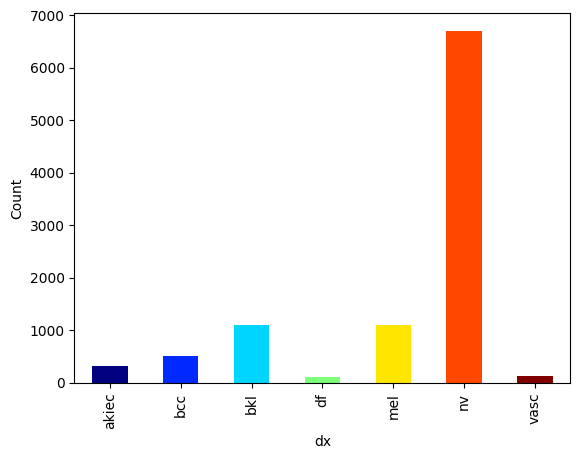

In [5]:
count = metadata.dx.value_counts().sort_index()

unique_vals = count.index
colors = plt.cm.jet(np.linspace(0, 1, len(unique_vals)))

count.plot(kind='bar', color=colors)

plt.ylabel('Count')
plt.show()

In [6]:
def check_for_missing_data(df):
    summary = pd.DataFrame(df.dtypes,columns=['dtypes'])
    summary = summary.reset_index()
    summary['Name'] = summary['index']
    summary = summary[['Name','dtypes']]
    summary['Missing'] = df.isnull().sum().values
    return summary

check_for_missing_data(metadata)

,Name,dtypes,Missing
0,lesion_id,object,0
1,image_id,object,0
2,dx,object,0
3,dx_type,object,0
4,age,float64,57
5,sex,object,0
6,localization,object,0


In [7]:
metadata.fillna({'age': metadata['age'].mean()}, inplace=True)


In [8]:
def convert_float_to_int(df, column_name):
    if df[column_name].dtype == 'float64':
        df[column_name] = df[column_name].astype(int)
    return df

metadata = convert_float_to_int(metadata,'age')
metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10015 entries, 0 to 10014
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   lesion_id     10015 non-null  object
 1   image_id      10015 non-null  object
 2   dx            10015 non-null  object
 3   dx_type       10015 non-null  object
 4   age           10015 non-null  int64 
 5   sex           10015 non-null  object
 6   localization  10015 non-null  object
dtypes: int64(1), object(6)
memory usage: 547.8+ KB


Remove the duplicates uf there are any

In [9]:
def check_for_duplicate_rows(df):
    size = df.shape
    sum_duplicates = df.duplicated().sum()
    sum_null = df.isnull().sum()
    return print("Number of Samples:" ,size[0],"\nDuplicated Entries: " ,sum_duplicates,"\nNull Entries:","\n",sum_null)

check_for_duplicate_rows(metadata)

Number of Samples: 10015 
Duplicated Entries:  0 
Null Entries: 
 lesion_id       0
image_id        0
dx              0
dx_type         0
age             0
sex             0
localization    0
dtype: int64


In [10]:
lesion_id_cnt = metadata['lesion_id'].value_counts()
def check_duplicates_lesions(id):
    if lesion_id_cnt[id] > 1:
        return True
    else:
        return False

metadata['dup_les'] = metadata['lesion_id'].map(check_duplicates_lesions)

metadata['dup_les'].value_counts()

dup_les
False    5514
True     4501
Name: count, dtype: int64

In [11]:
metadata = metadata[metadata.dup_les == False]
metadata.shape

(5514, 8)

### Load the image paths

Create 2 paths from input. The images are separated in these paths, so if they do not exist in path 1 they probably exist in path 2. Scanning all the rows using the "dx" and the "image_id" columns we can add the image path in a separete column in the dataframe.

In [12]:
base1_path = '/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1'
base2_path = '/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2'

image_paths = []

for index, row in metadata.iterrows():
    image_id = row['image_id']

    image_path_1 = os.path.join(base1_path, f'{image_id}.jpg')
    image_path_2 = os.path.join(base2_path, f'{image_id}.jpg')

    if os.path.exists(image_path_1):
        image_paths.append(image_path_1)
    elif os.path.exists(image_path_2):
        image_paths.append(image_path_2)
    else:
        print(f'Image {image_id} not found in either path.')

# Add the image paths to your DataFrame
metadata['image_path'] = image_paths

metadata.head()


,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path
10,HAM_0001396,ISIC_0025276,bkl,histo,55,female,trunk,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
15,HAM_0007207,ISIC_0031326,bkl,histo,65,male,back,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
20,HAM_0006071,ISIC_0032343,bkl,histo,70,female,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
33,HAM_0005612,ISIC_0024981,bkl,histo,80,male,scalp,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
34,HAM_0005388,ISIC_0027815,bkl,histo,80,male,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...


In [13]:
metadata.shape

(5514, 9)

### Exploration

<Axes: ylabel='count'>

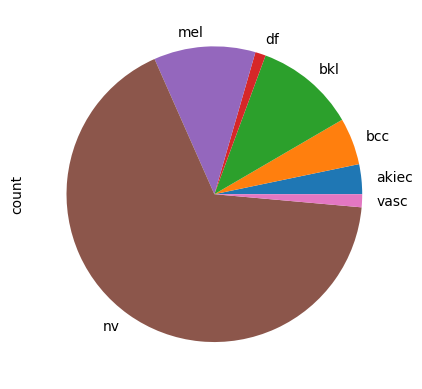

In [14]:
count.plot(kind='pie')

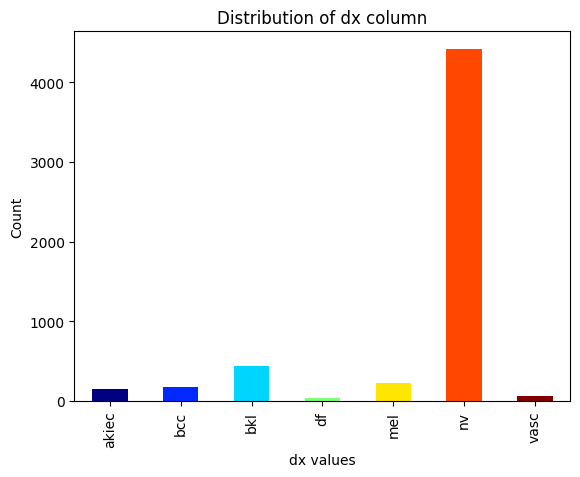

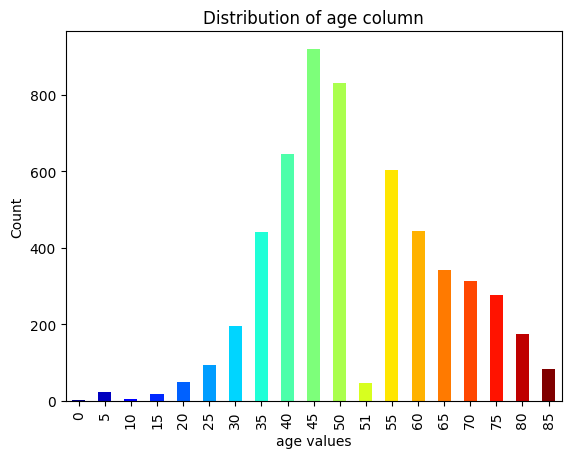

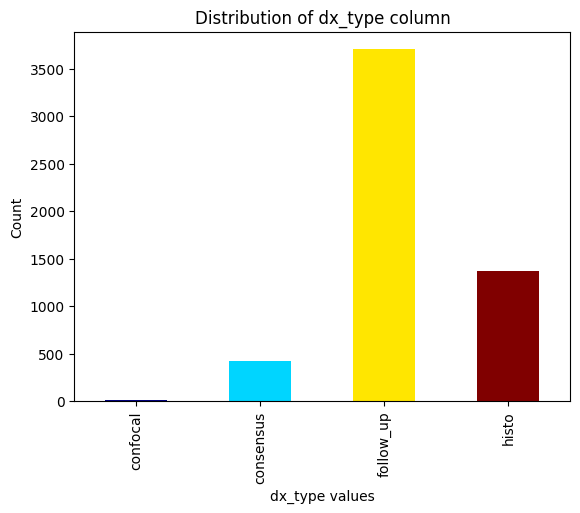

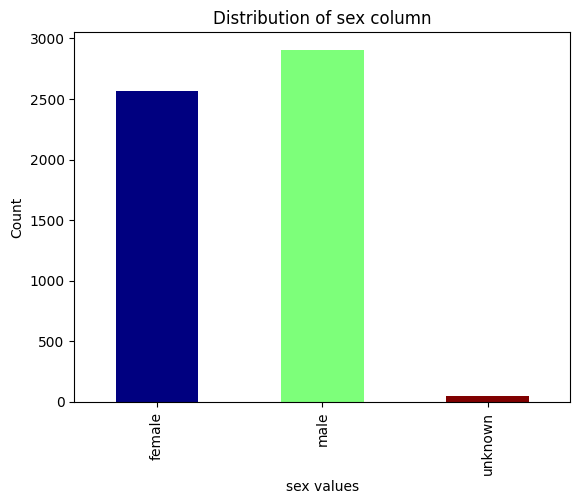

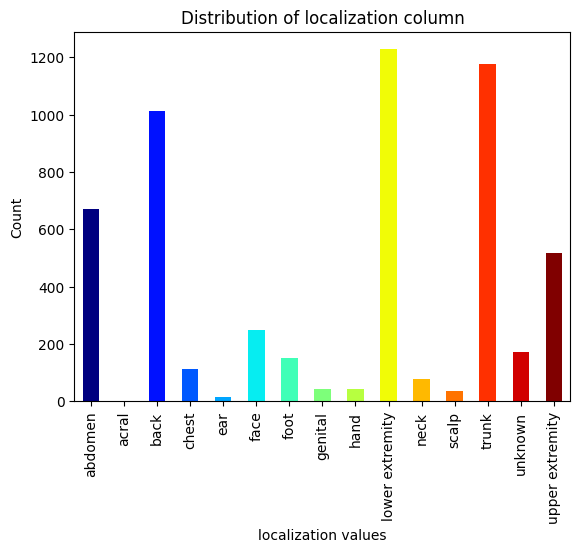

In [15]:
columns_exp = ['dx','age','dx_type', 'sex', 'localization']

for column in columns_exp:
  count = metadata[column].value_counts().sort_index()

  unique_vals = count.index
  colors = plt.cm.jet(np.linspace(0, 1, len(unique_vals)))

  count.plot(kind='bar', color=colors)

  plt.xlabel(f'{column} values')
  plt.ylabel('Count')
  plt.title(f'Distribution of {column} column')
  plt.show()

In [16]:
metadata.loc[metadata['sex']=='unknown'].shape

(45, 9)

In [17]:
metadata.loc[metadata['localization']=='unknown'].shape


(173, 9)

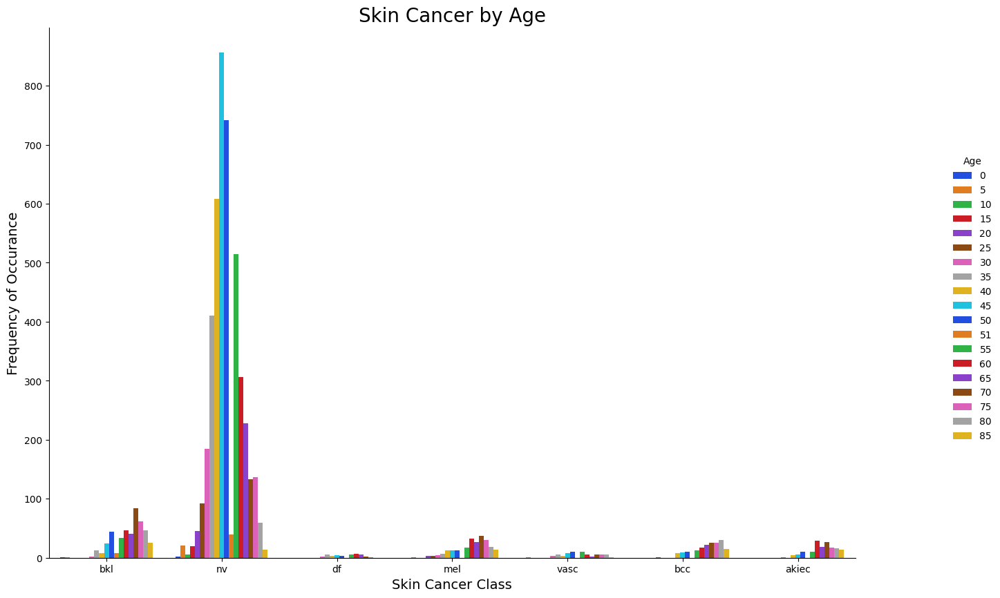

In [18]:
#Skin Cancer by age
g = sns.catplot(x="dx", kind="count", hue="age", palette='bright', data=metadata)
g.fig.set_size_inches(16, 9)

g.ax.set_title('Skin Cancer by Age', fontsize=20)
g.set_xlabels('Skin Cancer Class', fontsize=14)
g.set_ylabels('Frequency of Occurance', fontsize=14)
g._legend.set_title('Age')

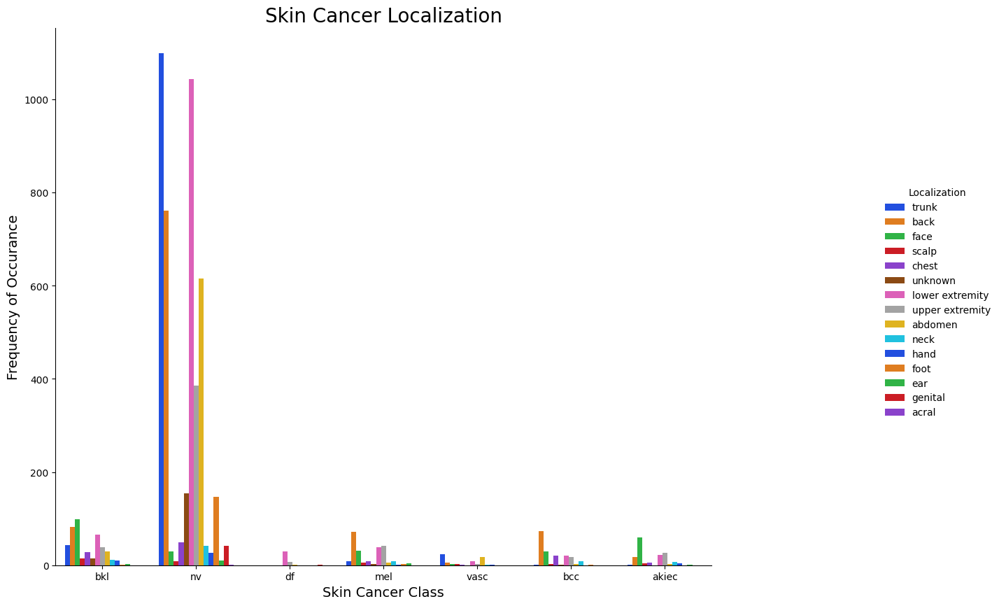

In [19]:
g = sns.catplot(x="dx", kind="count", hue="localization", palette='bright', data=metadata)
g.fig.set_size_inches(16, 9)

g.ax.set_title('Skin Cancer Localization', fontsize=20)
g.set_xlabels('Skin Cancer Class', fontsize=14)
g.set_ylabels('Frequency of Occurance', fontsize=14)
g._legend.set_title('Localization')

In [20]:
metadata.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path
10,HAM_0001396,ISIC_0025276,bkl,histo,55,female,trunk,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
15,HAM_0007207,ISIC_0031326,bkl,histo,65,male,back,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
20,HAM_0006071,ISIC_0032343,bkl,histo,70,female,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
33,HAM_0005612,ISIC_0024981,bkl,histo,80,male,scalp,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
34,HAM_0005388,ISIC_0027815,bkl,histo,80,male,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...


### Plot images from each class and their color distributions

In [21]:
def pltImg(images, labels, row_num, col_num):
    fig, axes = plt.subplots(row_num, col_num, figsize=(15, 8))
    axes = axes.ravel()  # Flatten axes array

    for i, image in enumerate(images):
        axes[i].imshow(image)
        axes[i].axis('off')
        axes[i].set_title(f"Class: {labels[i]}\nMean intensity: {np.mean(image):.1f}")

    plt.tight_layout()
    plt.show()


def pltHist(images, labels, row_num, col_num):
    fig, axes = plt.subplots(row_num, col_num, figsize=(15, 8))
    axes = axes.ravel()  # Flatten axes array
    colors = ["red", "green", "blue"]

    for i, image in enumerate(images):
        image_array = np.array(image)

        # Plotting all channels with colors
        for channel in range(3):
            hist, bin_edges = np.histogram(image_array[:, :, channel], bins=256, range=(0, 256))
            axes[i].plot(bin_edges[:-1], hist, color=colors[channel])

        axes[i].set_title(f"Class: {labels[i]}")

    plt.tight_layout()
    plt.show()

In [22]:
def randImg(df, label, seed, sample_size):
    # Filter dataframe for specific label/class
    df_class = df[df['dx'] == label]

    # Randomly sample images from this class
    random.seed(seed)
    sample_df = df_class.sample(n=sample_size)

    images = []
    labels = []
    for index, row in sample_df.iterrows():
        image_path = row['image_path']
        if os.path.exists(image_path):
            image = Image.open(image_path)
            images.append(image)
            labels.append(label)
        else:
            print(f"Image not found: {image_path}")

    return images, labels


--- Showcasing examples for class: bkl ---



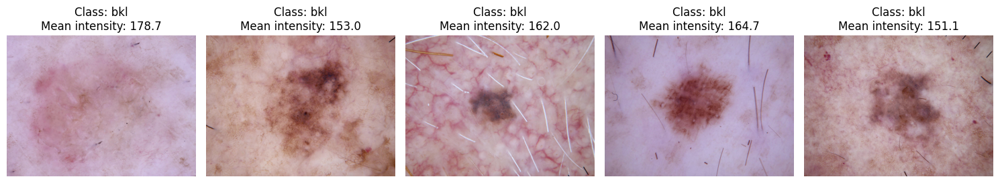

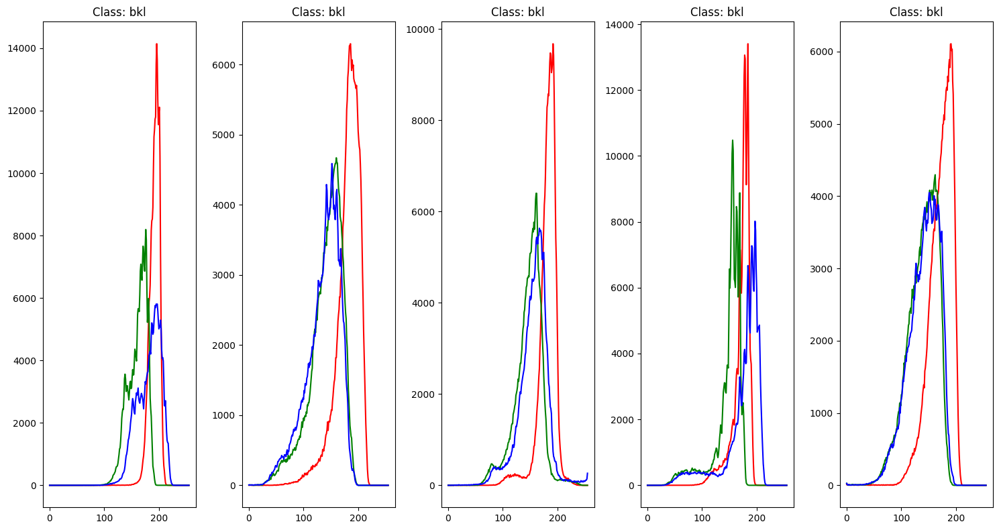


--- Showcasing examples for class: nv ---



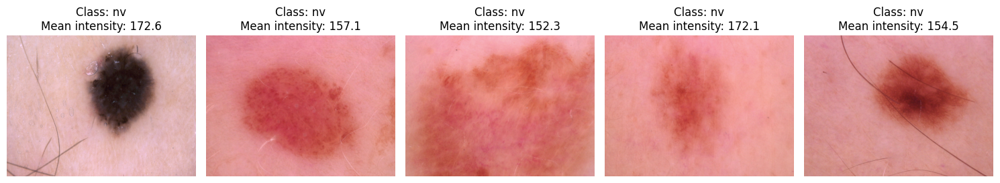

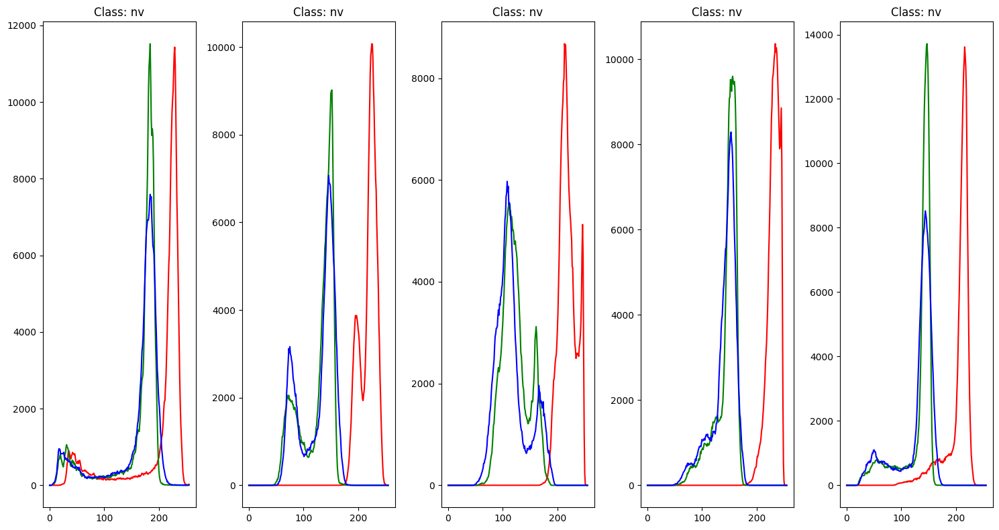


--- Showcasing examples for class: df ---



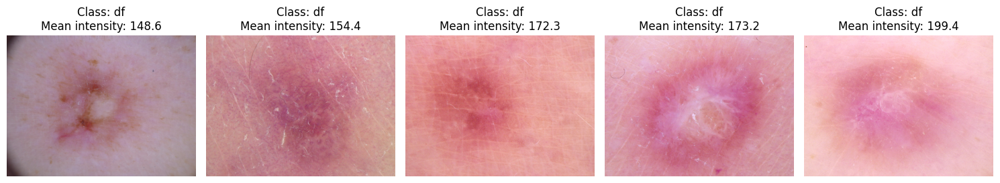

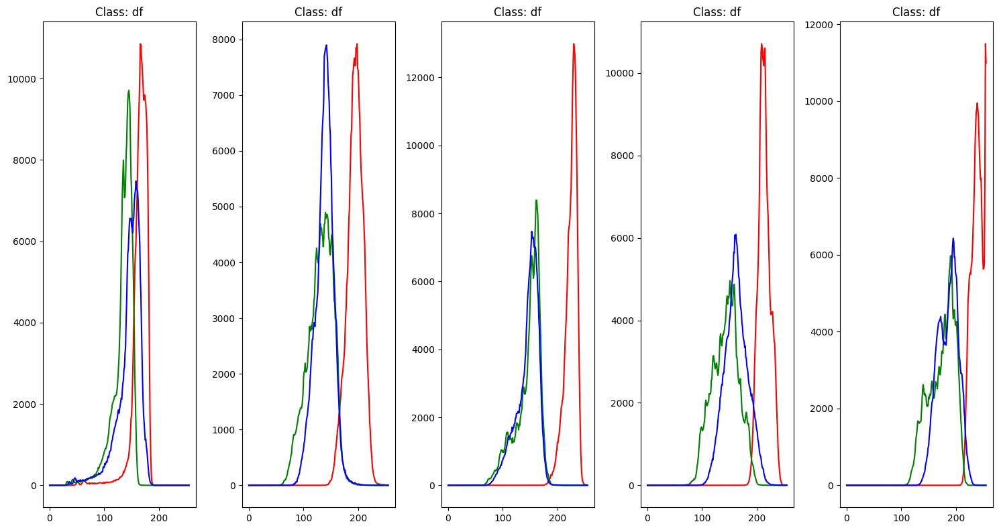


--- Showcasing examples for class: mel ---



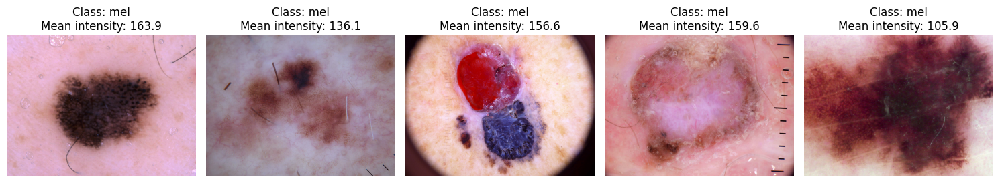

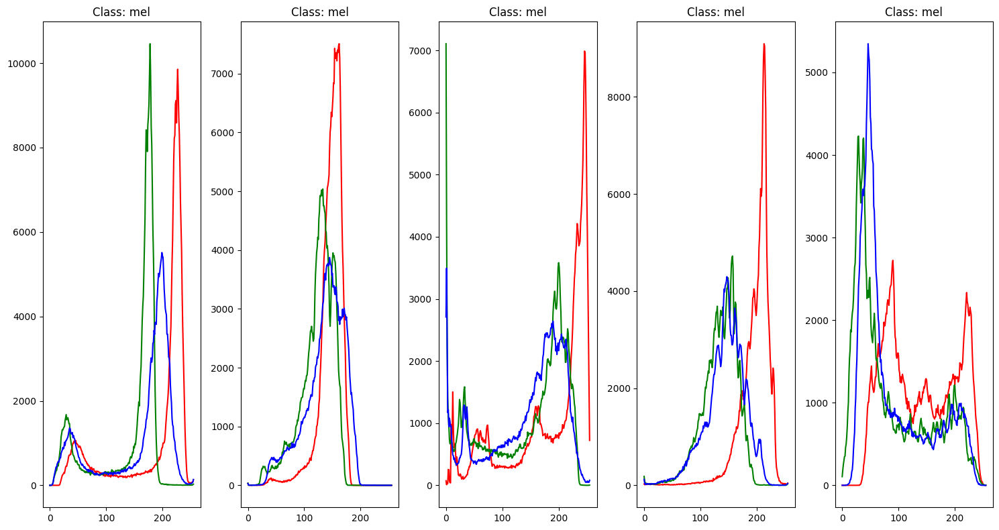


--- Showcasing examples for class: vasc ---



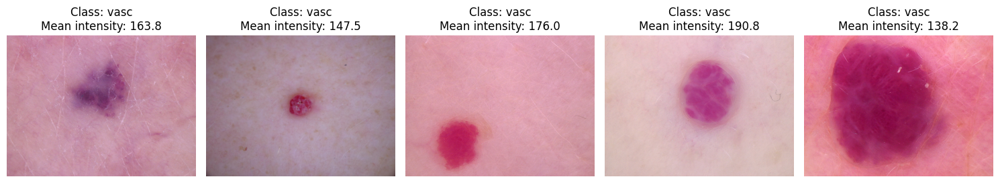

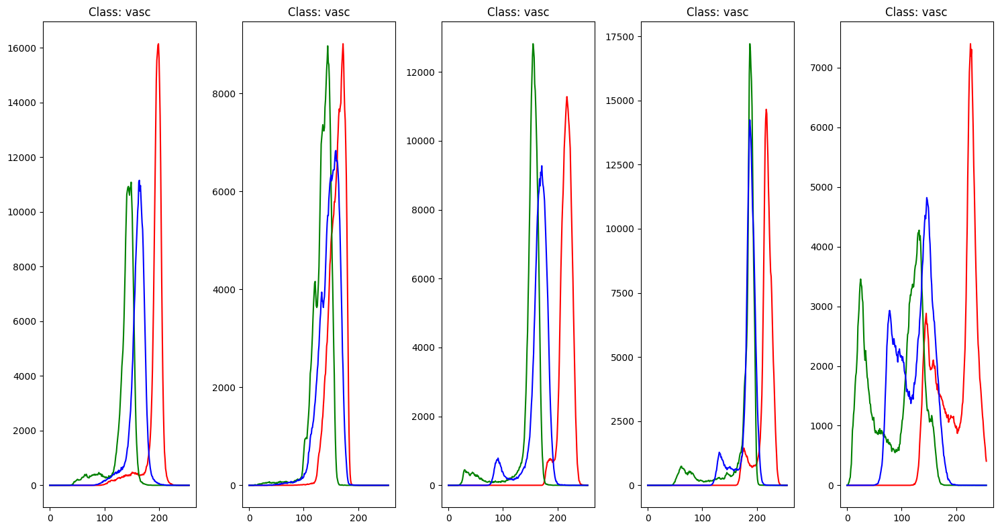


--- Showcasing examples for class: bcc ---



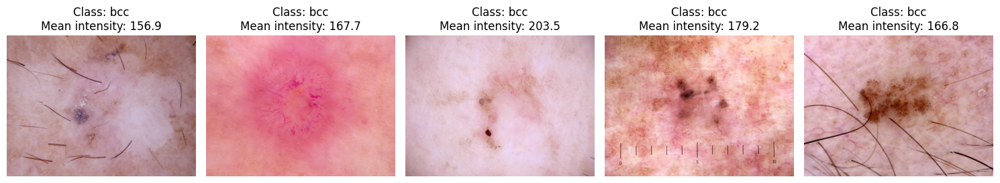

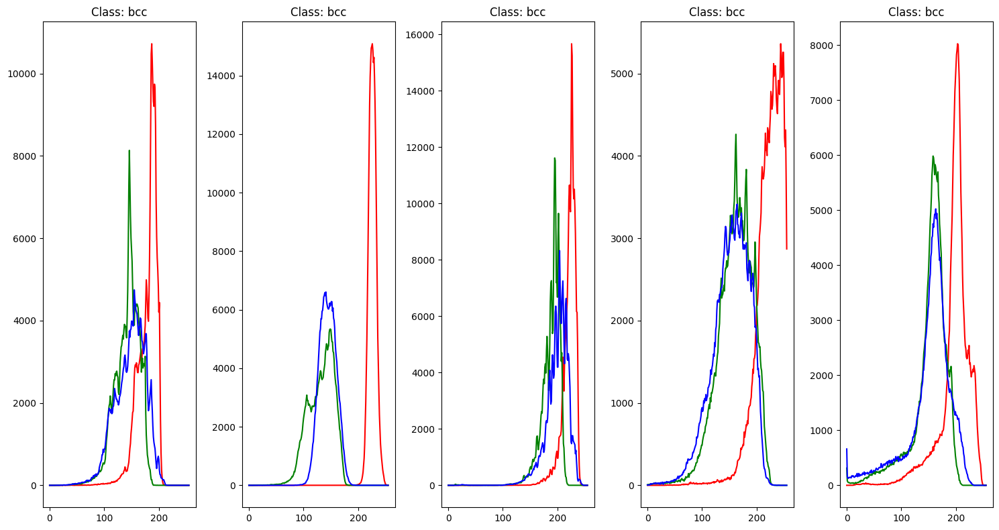


--- Showcasing examples for class: akiec ---



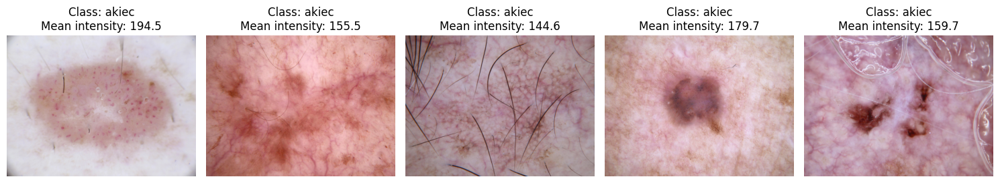

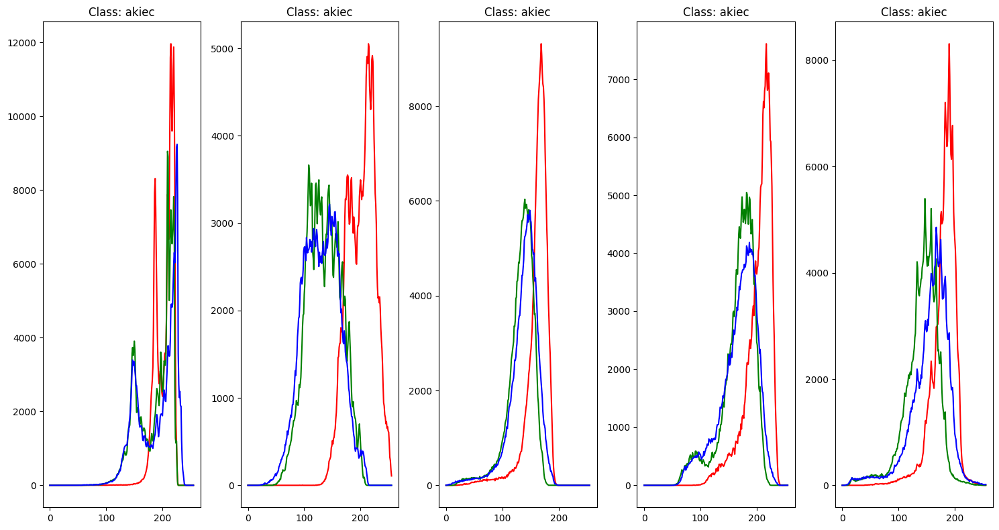

In [23]:
class_labels = ['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec']

for class_label in class_labels:
    print(f"\n--- Showcasing examples for class: {class_label} ---\n")
    images, labels = randImg(df=metadata, label=class_label, seed=42, sample_size=5)

    # For displaying images
    pltImg(images, labels, 1, 5)
    # pltImgEq(images, labels, 1, 5)
    # For displaying histograms
    pltHist(images, labels, 1, 5)

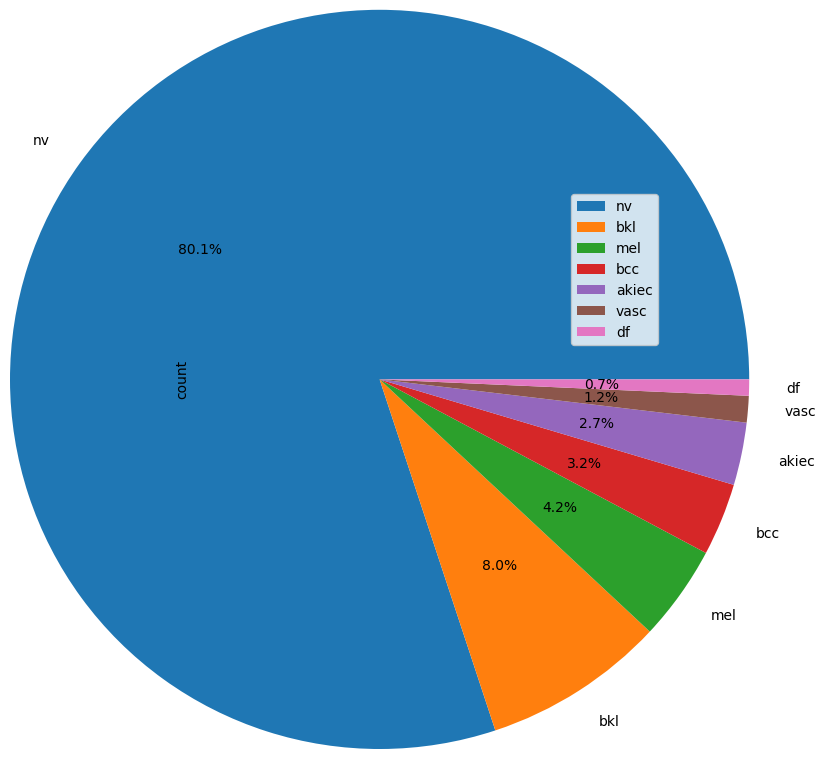

In [24]:
count = metadata['dx'].value_counts()
ax = count.plot(kind="pie", autopct='%1.1f%%', legend=True,radius=2.5)
ax.legend(bbox_to_anchor=(1, 1.02), loc='upper left')
plt.show()

In [25]:
count

dx
nv       4415
bkl       440
mel       230
bcc       175
akiec     151
vasc       64
df         39
Name: count, dtype: int64

LABELS :

Melanocytic nevi (nv) -
Melanocytic nevi are benign neoplasms of melanocytes and appear in a myriad of variants, which all are included in our series. The variants may differ significantly from a dermatoscopic point of view.

[4415 images]

Melanoma (mel) -
Melanoma is a malignant neoplasm derived from melanocytes that may appear in different variants. If excised in an early stage it can be cured by simple surgical excision. Melanomas can be invasive or non-invasive (in situ). We included all variants of melanoma including melanoma in situ, but did exclude non-pigmented, subungual, ocular or mucosal melanoma.

[230 images]

Benign keratosis-like lesions (bkl) -
"Benign keratosis" is a generic class that includes seborrheic ker- atoses ("senile wart"), solar lentigo - which can be regarded a flat variant of seborrheic keratosis - and lichen-planus like keratoses (LPLK), which corresponds to a seborrheic keratosis or a solar lentigo with inflammation and regression [22]. The three subgroups may look different dermatoscop- ically, but we grouped them together because they are similar biologically and often reported under the same generic term histopathologically. From a dermatoscopic view, lichen planus-like keratoses are especially challeng- ing because they can show morphologic features mimicking melanoma [23] and are often biopsied or excised for diagnostic reasons.

[440 images]

Basal cell carcinoma (bcc) -
Basal cell carcinoma is a common variant of epithelial skin cancer that rarely metastasizes but grows destructively if untreated. It appears in different morphologic variants (flat, nodular, pigmented, cystic, etc) [21], which are all included in this set.

[175 images]

Actinic keratoses (akiec) -
Actinic Keratoses (Solar Keratoses) and intraepithelial Carcinoma (Bowen’s disease) are common non-invasive, variants of squamous cell car- cinoma that can be treated locally without surgery. Some authors regard them as precursors of squamous cell carcinomas and not as actual carci- nomas. There is, however, agreement that these lesions may progress to invasive squamous cell carcinoma - which is usually not pigmented. Both neoplasms commonly show surface scaling and commonly are devoid of pigment. Actinic keratoses are more common on the face and Bowen’s disease is more common on other body sites. Because both types are in- duced by UV-light the surrounding skin is usually typified by severe sun damaged except in cases of Bowen’s disease that are caused by human papilloma virus infection and not by UV. Pigmented variants exists for Bowen’s disease [19] and for actinic keratoses [20]. Both are included in this set.

[151 images]

Vascular lesions (vasc) -
Vascular skin lesions in the dataset range from cherry angiomas to angiokeratomas [25] and pyogenic granulomas [26]. Hemorrhage is also included in this category.

[64 images]

Dermatofibrom (df) -
Dermatofibroma is a benign skin lesion regarded as either a benign proliferation or an inflammatory reaction to minimal trauma. It is brown often showing a central zone of fibrosis dermatoscopically [24].

[39 images]

[Total images = 5514]

### Data Augmentation

In [26]:
metadata.dx.unique()

array(['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec'], dtype=object)

In [27]:
count = metadata['dx'].value_counts().sort_index()
count

dx
akiec     151
bcc       175
bkl       440
df         39
mel       230
nv       4415
vasc       64
Name: count, dtype: int64

<Axes: ylabel='count'>

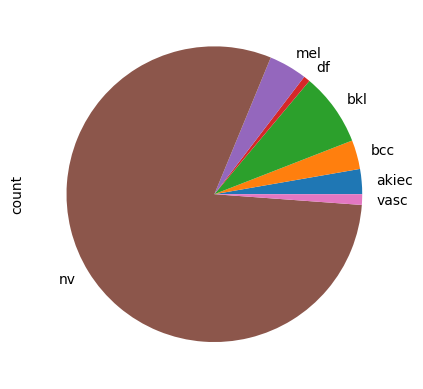

In [28]:
count.plot(kind='pie')

From this pie plot, we can see the huge imbalance between classes.

In [29]:
"""
def data_aug(df, col_name, val_name, class_max):
  ''' This function balances the classes by 2 using the overrepresentation of the minor class'''
  given_cols = df[df[col_name].isin([val_name, class_max])]
  class_counts = df[col_name].value_counts()
  class_count_max = class_counts[class_max]
  class_count_val = class_counts[val_name]
  max_class = given_cols[given_cols[col_name]==class_max]
  val_class = given_cols[given_cols[col_name]==val_name]
  val_class_over = val_class.sample(class_count_max,replace= True)
  df = df[df[col_name] != val_name]
  df = pd.concat([df,val_class_over],axis=0)
  return df
    """

"\ndef data_aug(df, col_name, val_name, class_max):\n  ''' This function balances the classes by 2 using the overrepresentation of the minor class'''\n  given_cols = df[df[col_name].isin([val_name, class_max])]\n  class_counts = df[col_name].value_counts()\n  class_count_max = class_counts[class_max]\n  class_count_val = class_counts[val_name]\n  max_class = given_cols[given_cols[col_name]==class_max]\n  val_class = given_cols[given_cols[col_name]==val_name]\n  val_class_over = val_class.sample(class_count_max,replace= True)\n  df = df[df[col_name] != val_name]\n  df = pd.concat([df,val_class_over],axis=0)\n  return df\n    "

In [30]:
"""
class_max = count.idxmax()

for val_name in metadata.dx.unique():
  if val_name != class_max:
    metadata = data_aug(metadata,'dx',val_name,class_max)

metadata.shape
"""

"\nclass_max = count.idxmax()\n\nfor val_name in metadata.dx.unique():\n  if val_name != class_max:\n    metadata = data_aug(metadata,'dx',val_name,class_max)\n\nmetadata.shape\n"

In [31]:
"""
count = metadata['dx'].value_counts().sort_index()
count.plot(kind='pie')
"""

"\ncount = metadata['dx'].value_counts().sort_index()\ncount.plot(kind='pie')\n"

### Data Export

For metadata['dx']:

'bkl': 0, 'nv': 1, 'df': 2, 'mel': 3, 'vasc': 4, 'bcc': 5, 'akiec': 6

In [32]:
"""
enum_labels = {'bkl': 0, 'nv': 1, 'df': 2, 'mel': 3, 'vasc': 4, 'bcc': 5, 'akiec': 6}

metadata['dx_cat'] = metadata['dx'].map(enum_labels)
"""

"\nenum_labels = {'bkl': 0, 'nv': 1, 'df': 2, 'mel': 3, 'vasc': 4, 'bcc': 5, 'akiec': 6}\n\nmetadata['dx_cat'] = metadata['dx'].map(enum_labels)\n"

In [33]:
"""metadata.dx_cat.unique()"""

'metadata.dx_cat.unique()'

In [34]:
"""metadata.to_csv('/kaggle/working/data_enum.csv', index=False)"""


"metadata.to_csv('/kaggle/working/data_enum.csv', index=False)"

The new file `data_enum.csv` it was created and saved in `Output` (working) directory. This directory is writable and is the default working directory in a Kaggle notebook.

______

Data augmentation maintaining unbalanced dataset

<Axes: ylabel='count'>

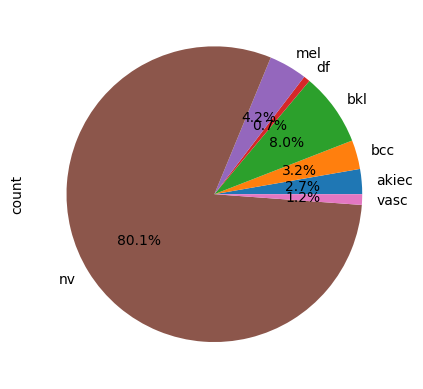

In [35]:
from sklearn.utils import shuffle

# We will perform data augmentation maintaining the class distribution

def data_aug_unbalanced(df, col_name, val_name, augmentation_factor):
    given_class = df[df[col_name] == val_name]
    original_count = len(given_class)
    target_count = int(original_count * augmentation_factor)

    # sample with replacement to generate aaugmented data
    augmented_class = given_class.sample(target_count, replace=True, random_state=42)

    return augmented_class

# get class counts and proportions
class_counts = metadata['dx'].value_counts()
class_proportions = class_counts / len(metadata)

# Define the augmentation factor for the entire dataset
augmentation_factor = 3  # E.g., double the dataset size

# Initialize an empty DataFrame to store the augmented dataset
augmented_metadata = pd.DataFrame()

# Perform augmentation for each class proportionally
for class_label, proportion in class_proportions.items():
    augmented_class = data_aug_unbalanced(
        metadata, col_name='dx', val_name=class_label, augmentation_factor=augmentation_factor
    )
    augmented_metadata = pd.concat([augmented_metadata, augmented_class], axis=0)

# Shuffle the augmented dataset to ensure randomness
augmented_metadata = shuffle(augmented_metadata, random_state=42).reset_index(drop=True)

# Map class labels to categorical values
enum_labels = {'bkl': 0, 'nv': 1, 'df': 2, 'mel': 3, 'vasc': 4, 'bcc': 5, 'akiec': 6}
augmented_metadata['dx_cat'] = augmented_metadata['dx'].map(enum_labels)

# Export the augmented dataset to a CSV file
augmented_metadata.to_csv('data_unbalanced.csv', index=False)

# Optional: Visualize the class distribution
class_distribution = augmented_metadata['dx'].value_counts().sort_index()
class_distribution.plot(kind='pie', autopct='%1.1f%%')

# CNN model

In [36]:
!pip install torchsummary
!pip install Dataloaders

In [37]:
from tqdm import tqdm

from skimage import io, transform
from sklearn.model_selection import train_test_split
from sklearn.metrics import  accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
import torch.optim as optim
from torch.autograd import Variable
import torchvision
from torchvision import models,transforms

#from Dataloaders.HAM10000Dataset import HAM10000Dataset
#from functions import normalization, Model_functions

import time

import random
from PIL import Image
import cv2
import gc
import optuna
import logging

______

## HAM10000Dataset

In [38]:
class HAM10000Dataset(Dataset):
    def __init__(self, data, label_column='dx_cat', img_col='image_path', transform=None):
        """
        Custom Dataset for loading HAM10000 images and labels.

        Args:
            data (pd.DataFrame): DataFrame containing image paths and labels.
            label_column (str): Name of the column containing labels.
            img_col (str): Name of the column containing image paths.
            transform (callable, optional): Optional transform to be applied on an image.
        """
        self.data = data.reset_index(drop=True)
        self.label_column = label_column
        self.img_col = img_col
        self.transform = transform

    def __len__(self):
        """Returns the total number of samples."""
        return len(self.data)

    def __getitem__(self, idx):
        """Generates one sample of data."""
        # Get image path
        image_path = self.data.at[idx, self.img_col]

        # Open image
        image = Image.open(image_path).convert('RGB')

        # Get label
        label = self.data.at[idx, self.label_column]
        label = torch.tensor(label, dtype=torch.long)

        # Apply transformations
        if self.transform:
            image = self.transform(image)

        return image, label

### Model Functions

In [39]:
def train_epoch(model, train_loader, criterion, optimizer, device):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0

    for data, labels in train_loader:
        data, labels = data.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(data)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    avg_train_loss = train_loss / len(train_loader)
    train_accuracy = 100 * correct / total
    return avg_train_loss, train_accuracy

def validate_epoch(model, val_loader, criterion, device):
    model.eval()
    valid_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for data, labels in val_loader:
            data, labels = data.to(device), labels.to(device)
            outputs = model(data)
            loss = criterion(outputs, labels)

            valid_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    avg_valid_loss = valid_loss / len(val_loader)
    valid_accuracy = 100 * correct / total
    return avg_valid_loss, valid_accuracy

def test_model(model, test_loader, device):
    model.eval()
    correct = 0
    total = 0

    with torch.no_grad():
        for data, labels in test_loader:
            data, labels = data.to(device), labels.to(device)
            outputs = model(data)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    test_accuracy = 100 * correct / total
    return test_accuracy

def train_and_validate_model(model, train_loader, val_loader, test_loader, criterion, patience, optimizer, device, epochs, model_filename, verbose=False):
    min_valid_loss = np.inf

    total_loss_train = []
    total_loss_val = []
    total_acc_train = []
    total_acc_val = []
    stopping_ct = 0

    for epoch in tqdm(range(epochs)):
        if stopping_ct < patience:            
            train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)
            valid_loss, valid_acc = validate_epoch(model, val_loader, criterion, device)

            total_loss_train.append(train_loss)
            total_loss_val.append(valid_loss)
            total_acc_train.append(train_acc)
            total_acc_val.append(valid_acc)
            if verbose:
                print(f'Epoch {epoch+1}')
                print(f'Training Loss: {train_loss} \nTraining Accuracy: {train_acc}%')
                print(f'Validation Loss: {valid_loss} \nValidation Accuracy: {valid_acc}%')
                print('=======================================================================')
        if min_valid_loss > valid_loss:
            print(f'Validation Loss Decreased({min_valid_loss:.6f}--->{valid_loss:.6f}) \nSaving The Model')
            print('=======================================================================')
            min_valid_loss = valid_loss
            torch.save(model.state_dict(), model_filename)
            stopping_ct = 0
        else:
            stopping_ct += 1

    best_model_state = torch.load(model_filename)
    model.load_state_dict(best_model_state)
    return model,total_loss_train, total_loss_val, total_acc_train, total_acc_val


def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False


def initialise_model(model_name, num_classes, feature_extract, use_pretrained=True):
    '''
    grad = if the pretrained weights be updated
    use_pretrained = use pre trained weights or start from scratch
    '''
    model = None
    
    if model_name == 'resnet_pret':
        model_ft = models.resnet50(pretrained=use_pretrained)
        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.fc.in_features
        model_ft.fc = nn.Linear(num_ftrs, num_classes)
    elif model_name == 'densenet_pret':
        model_ft = models.densenet121(pretrained=use_pretrained)
        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier.in_features
        model_ft.classifier = nn.Linear(num_ftrs, num_classes)
    else:
        print("Invalid model name, choose between 'resnet_pret', 'densenet_pret'.")
        exit()
    return model_ft


def conf_report(model_fitted,loader, model_type):
    """
    Generate and display a confusion matrix and a classification report for the predictions made by a model.

    Parameters:
    - model_fitted: The trained model that will be used to make predictions. The model should be compatible
                    with the data provided by the loader and should have a `to` method for device management
                    and an `argmax` method for getting predictions.
    - loader: A data loader that provides batches of data. Each batch should be a tuple containing data
              and its corresponding labels. The loader should be iterable.
    - model_type: A string indicating the type of the model. This is used for labeling purposes
                  when saving the confusion matrix figure.

    The function does the following:
    - Iterates over the provided data loader to collect model predictions and true labels.
    - Computes a confusion matrix both in raw and normalized form.
    - Displays heatmaps for both raw and normalized confusion matrices.
    - Prints a classification report showing main classification metrics.

    Outputs:
    - A figure with two subplots: the left one showing the normalized confusion matrix and the right
      one showing the raw confusion matrix. The figure is saved as 'Confusion_Matrix_{model_type}.png'.
    - A printed classification report in the console.
    """
    y_pred = []
    y_true = []
    for data, target in loader:
        data, target = data.to('cpu'), target.to('cpu')
        model_cpu = model_fitted.to('cpu')
        output = model_cpu(data)
        y_pred.extend(output.argmax(dim=1).tolist())
        y_true.extend(target.tolist())
    
    classes = [ 'bkl','nv','df','mel','vasc','bcc','akiec']

    cf_matrix = confusion_matrix(y_true, y_pred)
    df_temp = pd.DataFrame(cf_matrix / np.sum(cf_matrix, axis=1)[:, np.newaxis], index=classes, columns=classes)

    plt.figure(figsize=(24, 10))  

    plt.subplot(1, 2, 1)  
    sns.heatmap(df_temp, annot=True, fmt=".3f", cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

    plt.subplot(1, 2, 2)  
    sns.heatmap(cf_matrix, annot=True, fmt='g', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title('Raw Confusion Matrix')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

    plt.savefig(f'Confusion_Matrix_{model_type}.png')
    plt.show()

    report = classification_report(y_true, y_pred, target_names=classes)
    print('-------------------------------------------------------')
    print("Classification Report:\n")
    print(report)
    print('-------------------------------------------------------')

_____

In [40]:
data = pd.read_csv('/kaggle/working/data_unbalanced.csv')
data = data.sample(frac=1)
data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path,dx_cat
6482,HAM_0001030,ISIC_0027363,nv,follow_up,30,female,upper extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
8730,HAM_0004358,ISIC_0025393,nv,follow_up,25,female,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
10053,HAM_0006119,ISIC_0029944,nv,follow_up,40,female,upper extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
10024,HAM_0002848,ISIC_0027598,df,consensus,60,female,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,2
9477,HAM_0000469,ISIC_0025408,nv,follow_up,50,female,abdomen,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1


## Preprocessing

### Normalize function

In [41]:
img_h, img_w = 224, 224

norm_means = [0.77148203, 0.55764165, 0.58345652]
norm_std = [0.12655577, 0.14245141, 0.15189891]

### Data Augmentation and normalization

Resize the data as 224x224 because most pretrained models are implemented to work with these sizes

In [42]:
# define the transformation of the train images.
transform = transforms.Compose([transforms.Resize((img_h,img_w)),transforms.RandomHorizontalFlip(),
                                      transforms.RandomVerticalFlip(),transforms.RandomRotation(20),
                                      transforms.ColorJitter(brightness=0.1, contrast=0.1, hue=0.1),
                                        transforms.ToTensor(), transforms.Normalize(norm_means, norm_std)])
# define the transformation of the val and test images.
val_test_transform = transforms.Compose([transforms.Resize((img_h,img_w)), transforms.ToTensor(),
                                        transforms.Normalize(norm_means, norm_std)])

In [43]:
data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path,dx_cat
6482,HAM_0001030,ISIC_0027363,nv,follow_up,30,female,upper extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
8730,HAM_0004358,ISIC_0025393,nv,follow_up,25,female,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
10053,HAM_0006119,ISIC_0029944,nv,follow_up,40,female,upper extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
10024,HAM_0002848,ISIC_0027598,df,consensus,60,female,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,2
9477,HAM_0000469,ISIC_0025408,nv,follow_up,50,female,abdomen,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1


### Data Loading

In [44]:
train_val_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

train_data, val_data = train_test_split(train_val_data, test_size=0.5, random_state=42)

train_dataset = HAM10000Dataset(train_data, transform=transform)
val_dataset = HAM10000Dataset(val_data, transform=transform)
test_dataset = HAM10000Dataset(test_data, transform=transform)

In [45]:
batch_size = 64
num_workers = 4

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_loader = DataLoader(val_dataset, batch_size=batch_size, num_workers=num_workers)
test_loader = DataLoader(test_dataset, batch_size=batch_size, num_workers=num_workers)

print('Data len Train:', len(train_dataset), 'Val:', len(val_dataset), 'Test:', len(test_dataset))

Data len Train: 6616 Val: 6617 Test: 3309


### Batch check

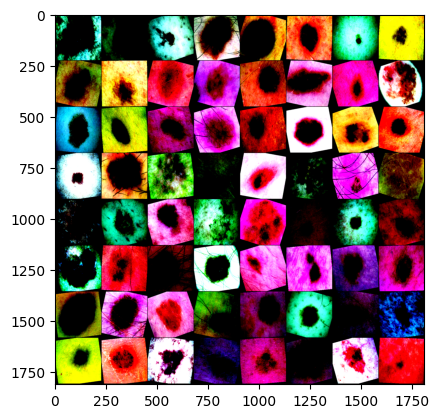

Labels:  tensor([6, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 6, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 6, 1, 1, 3, 1, 1, 3, 0, 1, 6, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 6, 1, 1, 1, 0, 1])


In [46]:
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# Get a batch of training data
dataiter = iter(train_loader)
images, labels = next(dataiter)

imshow(torchvision.utils.make_grid(images))
print('Labels: ', labels) 

In [47]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}')

Using device: cuda


# Hyperparameter tuning

Balanced subsample split

In [48]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

selected_data = (
    data
    .groupby('dx', as_index=False)
    .apply(lambda x: x.sample(n=500, replace=True))
    .reset_index(drop=True)
)
selected_data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path,dx_cat
0,HAM_0002343,ISIC_0028158,akiec,histo,70,female,back,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
1,HAM_0003633,ISIC_0030280,akiec,histo,70,male,upper extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
2,HAM_0004636,ISIC_0029541,akiec,histo,55,male,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
3,HAM_0005024,ISIC_0025803,akiec,histo,80,male,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
4,HAM_0001499,ISIC_0031929,akiec,histo,65,male,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6


In [49]:
class CNNet_trial(nn.Module):
    def __init__(self, num_filters, num_classes, num_of_layers):
        super(CNNet_trial, self).__init__()
        
        self.layers = nn.ModuleList()
        in_channels = 3         
        for out_channels in num_filters:
            self.layers.append(nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(),
                nn.MaxPool2d(kernel_size=2, stride=2)
            ))
            in_channels = out_channels
        
        self.flat_features = int(num_filters[-1] * (224/2**num_of_layers) * (224/2**num_of_layers))
        self.fc1 = nn.Linear(self.flat_features, 512)
        self.fc2 = nn.Linear(512, 128)
        self.fc3 = nn.Linear(128, num_classes)

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

In [50]:
train_val_trial, test_trial = train_test_split(selected_data, test_size=0.2, random_state=42)

train_trial, val_trial = train_test_split(selected_data, test_size=0.5, random_state=42)

train_trial = HAM10000Dataset(train_trial, transform=transform)
val_trial = HAM10000Dataset(val_trial, transform=transform)
test_trial = HAM10000Dataset(test_trial, transform=transform)

batch_size = 64
num_workers = 4

train_loader_trial = DataLoader(train_trial, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_loader_trial = DataLoader(val_trial, batch_size=batch_size, num_workers=num_workers)
test_loader_trial = DataLoader(test_trial, batch_size=batch_size, num_workers=num_workers)

print('Data len Train:', len(train_trial), 'Val:', len(val_trial), 'Test:', len(test_trial))

Data len Train: 1750 Val: 1750 Test: 700


### Set the optuna parameters

In [51]:
optuna.logging.set_verbosity(optuna.logging.WARNING)

def objective(trial):
    
    seed = 42
    torch.manual_seed(seed)
    random.seed(seed)
    
    num_of_layers = trial.suggest_int('num_of_layers', 3, 4)
    
    if num_of_layers == 4:
        num_filters_choices = [
            (16, 32, 64, 128),
            (32, 64, 128, 256),
            (64, 128, 256, 512),
            (16, 32, 128, 512),
            (32, 32, 64, 256),
            (32, 128, 256, 256),
            (32, 128, 128, 256),
            (128, 256, 512, 512)
        ]
        num_filters = trial.suggest_categorical('num_filters_4_layers', num_filters_choices)
    else:
        num_filters_choices = [
            (16, 64, 128),
            (32, 128, 256),
            (64, 128, 256),
            (128, 256, 512),
            (16, 32, 64),
            (16, 32, 128),
            (32, 128, 128),
            (64, 256, 256),
            (32, 256, 512),
            (16, 128, 512)
        ]
        num_filters = trial.suggest_categorical('num_filters_3_layers', num_filters_choices)
    
    learning_rate = trial.suggest_categorical('learning_rate', [1e-4, 1e-3])
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD','AdamW'])        
    epochs = 30
    patience =5  
    model = CNNet_trial(num_filters=num_filters, num_classes=7, num_of_layers=num_of_layers)
    model = model.to(device)
    input_size = (3, 224, 224)
    criterion = nn.CrossEntropyLoss().to(device)

    optimizer = {
        'Adam': optim.Adam(model.parameters(), lr=learning_rate),
        'RMSprop': optim.RMSprop(model.parameters(), lr=learning_rate),
        'SGD': optim.SGD(model.parameters(), lr=learning_rate),
        'AdamW': optim.AdamW(model.parameters(), lr=learning_rate)
    }[optimizer_name]
        
    model_filename = f'CNN_model_trial_{trial.number}.pth'

    try:
        _, _, _, _, total_acc_val = train_and_validate_model(
            model, train_loader_trial, val_loader_trial, test_loader_trial, criterion, patience, optimizer, device, epochs,model_filename)

        return max(total_acc_val)  
    finally:
        del model, optimizer
        torch.cuda.empty_cache()
        gc.collect()

In [52]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10,show_progress_bar=True) 

print("Best trial:")
trial = study.best_trial
print(f" Validation Accuracy: {trial.value}")
print("  Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

  0%|          | 0/10 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (16, 64, 128) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (32, 128, 256) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (64, 128, 256) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persi

Validation Loss Decreased(inf--->1.908543) 
Saving The Model



  3%|▎         | 1/30 [00:23<11:31, 23.86s/it]

Validation Loss Decreased(1.908543--->1.809596) 
Saving The Model



  7%|▋         | 2/30 [00:46<10:49, 23.21s/it]

Validation Loss Decreased(1.809596--->1.718856) 
Saving The Model



 10%|█         | 3/30 [01:08<10:15, 22.80s/it]

Validation Loss Decreased(1.718856--->1.669019) 
Saving The Model



 13%|█▎        | 4/30 [01:31<09:47, 22.61s/it]

Validation Loss Decreased(1.669019--->1.628347) 
Saving The Model



 17%|█▋        | 5/30 [01:54<09:26, 22.68s/it]

Validation Loss Decreased(1.628347--->1.595133) 
Saving The Model



 20%|██        | 6/30 [02:16<09:00, 22.53s/it]

Validation Loss Decreased(1.595133--->1.572057) 
Saving The Model



 23%|██▎       | 7/30 [02:38<08:37, 22.51s/it]

Validation Loss Decreased(1.572057--->1.511791) 
Saving The Model



 27%|██▋       | 8/30 [03:01<08:14, 22.47s/it]

Validation Loss Decreased(1.511791--->1.503837) 
Saving The Model



 30%|███       | 9/30 [03:23<07:48, 22.30s/it]

Validation Loss Decreased(1.503837--->1.459968) 
Saving The Model



 37%|███▋      | 11/30 [04:07<07:01, 22.18s/it]

Validation Loss Decreased(1.459968--->1.389274) 
Saving The Model



 43%|████▎     | 13/30 [04:50<06:13, 21.97s/it]

Validation Loss Decreased(1.389274--->1.380506) 
Saving The Model



 47%|████▋     | 14/30 [05:13<05:53, 22.07s/it]

Validation Loss Decreased(1.380506--->1.356492) 
Saving The Model



 50%|█████     | 15/30 [05:35<05:31, 22.12s/it]

Validation Loss Decreased(1.356492--->1.313164) 
Saving The Model



 57%|█████▋    | 17/30 [06:19<04:47, 22.11s/it]

Validation Loss Decreased(1.313164--->1.305731) 
Saving The Model



 60%|██████    | 18/30 [06:42<04:26, 22.22s/it]

Validation Loss Decreased(1.305731--->1.296233) 
Saving The Model



 63%|██████▎   | 19/30 [07:04<04:04, 22.24s/it]

Validation Loss Decreased(1.296233--->1.278389) 
Saving The Model



 67%|██████▋   | 20/30 [07:27<03:43, 22.40s/it]

Validation Loss Decreased(1.278389--->1.274948) 
Saving The Model



 70%|███████   | 21/30 [07:49<03:22, 22.50s/it]

Validation Loss Decreased(1.274948--->1.255545) 
Saving The Model



 73%|███████▎  | 22/30 [08:12<02:59, 22.41s/it]

Validation Loss Decreased(1.255545--->1.234200) 
Saving The Model



 77%|███████▋  | 23/30 [08:34<02:37, 22.51s/it]

Validation Loss Decreased(1.234200--->1.211521) 
Saving The Model



 83%|████████▎ | 25/30 [09:18<01:50, 22.17s/it]

Validation Loss Decreased(1.211521--->1.187431) 
Saving The Model



 87%|████████▋ | 26/30 [09:41<01:29, 22.38s/it]

Validation Loss Decreased(1.187431--->1.182567) 
Saving The Model



 90%|█████████ | 27/30 [10:04<01:07, 22.50s/it]

Validation Loss Decreased(1.182567--->1.178611) 
Saving The Model



 93%|█████████▎| 28/30 [10:26<00:44, 22.38s/it]

Validation Loss Decreased(1.178611--->1.174541) 
Saving The Model



100%|██████████| 30/30 [11:09<00:00, 22.33s/it]
<ipython-input-39-ec0ac48c9ab1>:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load(model_filena

Validation Loss Decreased(inf--->4.669164) 
Saving The Model



  3%|▎         | 1/30 [00:38<18:29, 38.27s/it]

Validation Loss Decreased(4.669164--->2.206422) 
Saving The Model



  7%|▋         | 2/30 [01:16<17:49, 38.20s/it]

Validation Loss Decreased(2.206422--->2.070365) 
Saving The Model



 10%|█         | 3/30 [01:54<17:15, 38.36s/it]

Validation Loss Decreased(2.070365--->2.006917) 
Saving The Model



 13%|█▎        | 4/30 [02:34<16:46, 38.72s/it]

Validation Loss Decreased(2.006917--->1.960460) 
Saving The Model



 17%|█▋        | 5/30 [03:12<16:06, 38.67s/it]

Validation Loss Decreased(1.960460--->1.349399) 
Saving The Model



100%|██████████| 30/30 [06:54<00:00, 13.83s/it]
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (16, 32, 64, 128) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (32, 64, 128, 256) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (64, 128, 256, 512) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution

Validation Loss Decreased(inf--->1.586511) 
Saving The Model



  3%|▎         | 1/30 [00:23<11:07, 23.01s/it]

Validation Loss Decreased(1.586511--->1.350494) 
Saving The Model



  7%|▋         | 2/30 [00:45<10:36, 22.72s/it]

Validation Loss Decreased(1.350494--->1.223325) 
Saving The Model



 10%|█         | 3/30 [01:08<10:16, 22.85s/it]

Validation Loss Decreased(1.223325--->1.155358) 
Saving The Model



 13%|█▎        | 4/30 [01:31<09:53, 22.83s/it]

Validation Loss Decreased(1.155358--->1.102324) 
Saving The Model



 17%|█▋        | 5/30 [01:54<09:31, 22.86s/it]

Validation Loss Decreased(1.102324--->1.044010) 
Saving The Model



 23%|██▎       | 7/30 [02:39<08:43, 22.74s/it]

Validation Loss Decreased(1.044010--->0.987386) 
Saving The Model



 27%|██▋       | 8/30 [03:02<08:25, 22.97s/it]

Validation Loss Decreased(0.987386--->0.915714) 
Saving The Model



 30%|███       | 9/30 [03:25<08:02, 22.96s/it]

Validation Loss Decreased(0.915714--->0.897831) 
Saving The Model



 33%|███▎      | 10/30 [03:49<07:44, 23.21s/it]

Validation Loss Decreased(0.897831--->0.849514) 
Saving The Model



 40%|████      | 12/30 [04:35<06:54, 23.04s/it]

Validation Loss Decreased(0.849514--->0.818651) 
Saving The Model



 47%|████▋     | 14/30 [05:21<06:06, 22.94s/it]

Validation Loss Decreased(0.818651--->0.790567) 
Saving The Model



 57%|█████▋    | 17/30 [06:29<04:54, 22.67s/it]

Validation Loss Decreased(0.790567--->0.755588) 
Saving The Model



 60%|██████    | 18/30 [06:52<04:33, 22.78s/it]

Validation Loss Decreased(0.755588--->0.745247) 
Saving The Model



 73%|███████▎  | 22/30 [08:21<03:00, 22.57s/it]

Validation Loss Decreased(0.745247--->0.729942) 
Saving The Model



 77%|███████▋  | 23/30 [08:44<02:38, 22.60s/it]

Validation Loss Decreased(0.729942--->0.688324) 
Saving The Model



 80%|████████  | 24/30 [09:07<02:15, 22.64s/it]

Validation Loss Decreased(0.688324--->0.682465) 
Saving The Model



 87%|████████▋ | 26/30 [09:52<01:30, 22.55s/it]

Validation Loss Decreased(0.682465--->0.662506) 
Saving The Model



 90%|█████████ | 27/30 [10:15<01:08, 22.73s/it]

Validation Loss Decreased(0.662506--->0.647888) 
Saving The Model



 93%|█████████▎| 28/30 [10:38<00:45, 22.69s/it]

Validation Loss Decreased(0.647888--->0.622042) 
Saving The Model



 97%|█████████▋| 29/30 [11:01<00:22, 22.76s/it]

Validation Loss Decreased(0.622042--->0.616388) 
Saving The Model



100%|██████████| 30/30 [11:23<00:00, 22.79s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.924505) 
Saving The Model



  3%|▎         | 1/30 [00:22<10:46, 22.28s/it]

Validation Loss Decreased(1.924505--->1.873162) 
Saving The Model



  7%|▋         | 2/30 [00:44<10:26, 22.38s/it]

Validation Loss Decreased(1.873162--->1.828676) 
Saving The Model



 10%|█         | 3/30 [01:06<09:58, 22.17s/it]

Validation Loss Decreased(1.828676--->1.783522) 
Saving The Model



 13%|█▎        | 4/30 [01:28<09:36, 22.18s/it]

Validation Loss Decreased(1.783522--->1.738456) 
Saving The Model



 17%|█▋        | 5/30 [01:51<09:16, 22.27s/it]

Validation Loss Decreased(1.738456--->1.687567) 
Saving The Model



 20%|██        | 6/30 [02:13<08:50, 22.12s/it]

Validation Loss Decreased(1.687567--->1.662142) 
Saving The Model



 23%|██▎       | 7/30 [02:35<08:30, 22.19s/it]

Validation Loss Decreased(1.662142--->1.621716) 
Saving The Model



 27%|██▋       | 8/30 [02:57<08:09, 22.26s/it]

Validation Loss Decreased(1.621716--->1.582497) 
Saving The Model



 30%|███       | 9/30 [03:20<07:49, 22.36s/it]

Validation Loss Decreased(1.582497--->1.532194) 
Saving The Model



 33%|███▎      | 10/30 [03:42<07:23, 22.18s/it]

Validation Loss Decreased(1.532194--->1.530594) 
Saving The Model



 37%|███▋      | 11/30 [04:04<07:01, 22.17s/it]

Validation Loss Decreased(1.530594--->1.508125) 
Saving The Model



 40%|████      | 12/30 [04:26<06:40, 22.26s/it]

Validation Loss Decreased(1.508125--->1.473886) 
Saving The Model



 43%|████▎     | 13/30 [04:48<06:14, 22.04s/it]

Validation Loss Decreased(1.473886--->1.440003) 
Saving The Model



 47%|████▋     | 14/30 [05:10<05:53, 22.10s/it]

Validation Loss Decreased(1.440003--->1.427636) 
Saving The Model



 50%|█████     | 15/30 [05:32<05:30, 22.06s/it]

Validation Loss Decreased(1.427636--->1.397344) 
Saving The Model



 53%|█████▎    | 16/30 [05:53<05:05, 21.84s/it]

Validation Loss Decreased(1.397344--->1.386544) 
Saving The Model



 57%|█████▋    | 17/30 [06:15<04:44, 21.89s/it]

Validation Loss Decreased(1.386544--->1.350548) 
Saving The Model



 60%|██████    | 18/30 [06:37<04:22, 21.89s/it]

Validation Loss Decreased(1.350548--->1.329102) 
Saving The Model



 63%|██████▎   | 19/30 [06:59<03:59, 21.80s/it]

Validation Loss Decreased(1.329102--->1.321321) 
Saving The Model



 67%|██████▋   | 20/30 [07:21<03:38, 21.90s/it]

Validation Loss Decreased(1.321321--->1.289814) 
Saving The Model



 70%|███████   | 21/30 [07:43<03:17, 21.94s/it]

Validation Loss Decreased(1.289814--->1.265081) 
Saving The Model



 73%|███████▎  | 22/30 [08:05<02:54, 21.86s/it]

Validation Loss Decreased(1.265081--->1.261597) 
Saving The Model



 77%|███████▋  | 23/30 [08:27<02:33, 21.98s/it]

Validation Loss Decreased(1.261597--->1.238530) 
Saving The Model



 83%|████████▎ | 25/30 [09:10<01:48, 21.70s/it]

Validation Loss Decreased(1.238530--->1.214823) 
Saving The Model



 87%|████████▋ | 26/30 [09:32<01:27, 21.78s/it]

Validation Loss Decreased(1.214823--->1.210888) 
Saving The Model



 90%|█████████ | 27/30 [09:54<01:05, 21.83s/it]

Validation Loss Decreased(1.210888--->1.193055) 
Saving The Model



 93%|█████████▎| 28/30 [10:15<00:43, 21.72s/it]

Validation Loss Decreased(1.193055--->1.188214) 
Saving The Model



 97%|█████████▋| 29/30 [10:37<00:21, 21.81s/it]

Validation Loss Decreased(1.188214--->1.185947) 
Saving The Model



100%|██████████| 30/30 [11:00<00:00, 22.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.782204) 
Saving The Model



  7%|▋         | 2/30 [00:43<09:59, 21.42s/it]

Validation Loss Decreased(1.782204--->1.578814) 
Saving The Model



 10%|█         | 3/30 [01:05<09:47, 21.74s/it]

Validation Loss Decreased(1.578814--->1.518546) 
Saving The Model



 13%|█▎        | 4/30 [01:27<09:27, 21.82s/it]

Validation Loss Decreased(1.518546--->1.369029) 
Saving The Model



 17%|█▋        | 5/30 [01:48<09:03, 21.72s/it]

Validation Loss Decreased(1.369029--->1.334319) 
Saving The Model



 20%|██        | 6/30 [02:11<08:46, 21.93s/it]

Validation Loss Decreased(1.334319--->1.324122) 
Saving The Model



 23%|██▎       | 7/30 [02:33<08:26, 22.01s/it]

Validation Loss Decreased(1.324122--->1.192940) 
Saving The Model



 40%|████      | 12/30 [04:21<06:31, 21.76s/it]

Validation Loss Decreased(1.192940--->1.101740) 
Saving The Model



 43%|████▎     | 13/30 [04:43<06:11, 21.83s/it]

Validation Loss Decreased(1.101740--->1.095605) 
Saving The Model



 47%|████▋     | 14/30 [05:05<05:48, 21.80s/it]

Validation Loss Decreased(1.095605--->1.031433) 
Saving The Model



 50%|█████     | 15/30 [05:27<05:27, 21.84s/it]

Validation Loss Decreased(1.031433--->0.994658) 
Saving The Model



 53%|█████▎    | 16/30 [05:49<05:06, 21.86s/it]

Validation Loss Decreased(0.994658--->0.914784) 
Saving The Model



 70%|███████   | 21/30 [07:38<03:16, 21.83s/it]

Validation Loss Decreased(0.914784--->0.901796) 
Saving The Model



 73%|███████▎  | 22/30 [08:00<02:56, 22.05s/it]

Validation Loss Decreased(0.901796--->0.849124) 
Saving The Model



 83%|████████▎ | 25/30 [09:07<01:51, 22.27s/it]

Validation Loss Decreased(0.849124--->0.766310) 
Saving The Model



 97%|█████████▋| 29/30 [10:36<00:22, 22.27s/it]

Validation Loss Decreased(0.766310--->0.740747) 
Saving The Model



100%|██████████| 30/30 [10:58<00:00, 21.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.614410) 
Saving The Model



  3%|▎         | 1/30 [00:22<10:47, 22.32s/it]

Validation Loss Decreased(1.614410--->1.427967) 
Saving The Model



  7%|▋         | 2/30 [00:45<10:31, 22.54s/it]

Validation Loss Decreased(1.427967--->1.265318) 
Saving The Model



 10%|█         | 3/30 [01:06<09:59, 22.19s/it]

Validation Loss Decreased(1.265318--->1.218568) 
Saving The Model



 13%|█▎        | 4/30 [01:28<09:35, 22.14s/it]

Validation Loss Decreased(1.218568--->1.164683) 
Saving The Model



 20%|██        | 6/30 [02:12<08:47, 21.99s/it]

Validation Loss Decreased(1.164683--->1.066332) 
Saving The Model



 23%|██▎       | 7/30 [02:34<08:27, 22.06s/it]

Validation Loss Decreased(1.066332--->0.997438) 
Saving The Model



 30%|███       | 9/30 [03:18<07:41, 21.97s/it]

Validation Loss Decreased(0.997438--->0.971106) 
Saving The Model



 33%|███▎      | 10/30 [03:40<07:18, 21.90s/it]

Validation Loss Decreased(0.971106--->0.943067) 
Saving The Model



 37%|███▋      | 11/30 [04:02<06:57, 21.99s/it]

Validation Loss Decreased(0.943067--->0.880346) 
Saving The Model



 43%|████▎     | 13/30 [04:46<06:11, 21.83s/it]

Validation Loss Decreased(0.880346--->0.830310) 
Saving The Model



 53%|█████▎    | 16/30 [05:51<05:03, 21.66s/it]

Validation Loss Decreased(0.830310--->0.814457) 
Saving The Model



 57%|█████▋    | 17/30 [06:13<04:43, 21.82s/it]

Validation Loss Decreased(0.814457--->0.809197) 
Saving The Model



 63%|██████▎   | 19/30 [06:56<03:58, 21.69s/it]

Validation Loss Decreased(0.809197--->0.791137) 
Saving The Model



 73%|███████▎  | 22/30 [08:02<02:53, 21.63s/it]

Validation Loss Decreased(0.791137--->0.783444) 
Saving The Model



 77%|███████▋  | 23/30 [08:24<02:32, 21.76s/it]

Validation Loss Decreased(0.783444--->0.710312) 
Saving The Model



 83%|████████▎ | 25/30 [09:07<01:48, 21.76s/it]

Validation Loss Decreased(0.710312--->0.697650) 
Saving The Model



 90%|█████████ | 27/30 [09:51<01:05, 21.79s/it]

Validation Loss Decreased(0.697650--->0.681080) 
Saving The Model



100%|██████████| 30/30 [10:56<00:00, 21.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.632705) 
Saving The Model



  3%|▎         | 1/30 [00:30<14:50, 30.71s/it]

Validation Loss Decreased(1.632705--->1.556629) 
Saving The Model



  7%|▋         | 2/30 [01:01<14:26, 30.93s/it]

Validation Loss Decreased(1.556629--->1.314389) 
Saving The Model



 10%|█         | 3/30 [01:33<13:58, 31.06s/it]

Validation Loss Decreased(1.314389--->1.186167) 
Saving The Model



 17%|█▋        | 5/30 [02:32<12:34, 30.18s/it]

Validation Loss Decreased(1.186167--->1.107286) 
Saving The Model



 20%|██        | 6/30 [03:03<12:09, 30.39s/it]

Validation Loss Decreased(1.107286--->1.067451) 
Saving The Model



 27%|██▋       | 8/30 [04:03<10:57, 29.90s/it]

Validation Loss Decreased(1.067451--->0.989990) 
Saving The Model



 30%|███       | 9/30 [04:33<10:33, 30.19s/it]

Validation Loss Decreased(0.989990--->0.963273) 
Saving The Model



 37%|███▋      | 11/30 [05:32<09:24, 29.71s/it]

Validation Loss Decreased(0.963273--->0.861438) 
Saving The Model



 43%|████▎     | 13/30 [06:32<08:22, 29.58s/it]

Validation Loss Decreased(0.861438--->0.838673) 
Saving The Model



 60%|██████    | 18/30 [08:56<05:46, 28.84s/it]

Validation Loss Decreased(0.838673--->0.831641) 
Saving The Model



 63%|██████▎   | 19/30 [09:27<05:24, 29.51s/it]

Validation Loss Decreased(0.831641--->0.782371) 
Saving The Model



 73%|███████▎  | 22/30 [10:55<03:53, 29.20s/it]

Validation Loss Decreased(0.782371--->0.731812) 
Saving The Model



 83%|████████▎ | 25/30 [12:22<02:24, 28.99s/it]

Validation Loss Decreased(0.731812--->0.716845) 
Saving The Model



 87%|████████▋ | 26/30 [12:53<01:57, 29.43s/it]

Validation Loss Decreased(0.716845--->0.698269) 
Saving The Model



 97%|█████████▋| 29/30 [14:20<00:29, 29.13s/it]

Validation Loss Decreased(0.698269--->0.678063) 
Saving The Model



100%|██████████| 30/30 [14:51<00:00, 29.72s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->4.454351) 
Saving The Model



  3%|▎         | 1/30 [00:38<18:22, 38.03s/it]

Validation Loss Decreased(4.454351--->2.225377) 
Saving The Model



  7%|▋         | 2/30 [01:16<17:46, 38.09s/it]

Validation Loss Decreased(2.225377--->1.805881) 
Saving The Model



 10%|█         | 3/30 [01:55<17:20, 38.53s/it]

Validation Loss Decreased(1.805881--->1.742684) 
Saving The Model



 13%|█▎        | 4/30 [02:35<16:57, 39.15s/it]

Validation Loss Decreased(1.742684--->1.467716) 
Saving The Model



 17%|█▋        | 5/30 [03:14<16:15, 39.02s/it]

Validation Loss Decreased(1.467716--->1.366304) 
Saving The Model



 27%|██▋       | 8/30 [05:04<13:42, 37.39s/it]

Validation Loss Decreased(1.366304--->1.282074) 
Saving The Model



 33%|███▎      | 10/30 [06:20<12:29, 37.45s/it]

Validation Loss Decreased(1.282074--->1.196945) 
Saving The Model



 40%|████      | 12/30 [07:34<11:09, 37.18s/it]

Validation Loss Decreased(1.196945--->1.160713) 
Saving The Model



 50%|█████     | 15/30 [09:25<09:15, 37.04s/it]

Validation Loss Decreased(1.160713--->1.105672) 
Saving The Model



 53%|█████▎    | 16/30 [10:04<08:45, 37.51s/it]

Validation Loss Decreased(1.105672--->1.078992) 
Saving The Model



 57%|█████▋    | 17/30 [10:42<08:11, 37.78s/it]

Validation Loss Decreased(1.078992--->1.007125) 
Saving The Model



 60%|██████    | 18/30 [11:21<07:35, 37.99s/it]

Validation Loss Decreased(1.007125--->0.976070) 
Saving The Model



 70%|███████   | 21/30 [13:13<05:36, 37.43s/it]

Validation Loss Decreased(0.976070--->0.963025) 
Saving The Model



 73%|███████▎  | 22/30 [13:52<05:02, 37.83s/it]

Validation Loss Decreased(0.963025--->0.952728) 
Saving The Model



 80%|████████  | 24/30 [15:06<03:44, 37.46s/it]

Validation Loss Decreased(0.952728--->0.901730) 
Saving The Model



 83%|████████▎ | 25/30 [15:45<03:08, 37.72s/it]

Validation Loss Decreased(0.901730--->0.845086) 
Saving The Model



 93%|█████████▎| 28/30 [17:37<01:14, 37.32s/it]

Validation Loss Decreased(0.845086--->0.831609) 
Saving The Model



100%|██████████| 30/30 [18:52<00:00, 37.74s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.565275) 
Saving The Model



  3%|▎         | 1/30 [00:23<11:10, 23.12s/it]

Validation Loss Decreased(1.565275--->1.360934) 
Saving The Model



  7%|▋         | 2/30 [00:46<10:47, 23.13s/it]

Validation Loss Decreased(1.360934--->1.187917) 
Saving The Model



 10%|█         | 3/30 [01:09<10:20, 22.97s/it]

Validation Loss Decreased(1.187917--->1.166496) 
Saving The Model



 13%|█▎        | 4/30 [01:31<09:53, 22.85s/it]

Validation Loss Decreased(1.166496--->1.004839) 
Saving The Model



 20%|██        | 6/30 [02:17<09:10, 22.93s/it]

Validation Loss Decreased(1.004839--->0.989653) 
Saving The Model



 23%|██▎       | 7/30 [02:40<08:44, 22.80s/it]

Validation Loss Decreased(0.989653--->0.986420) 
Saving The Model



 27%|██▋       | 8/30 [03:03<08:23, 22.88s/it]

Validation Loss Decreased(0.986420--->0.892750) 
Saving The Model



 30%|███       | 9/30 [03:26<08:00, 22.90s/it]

Validation Loss Decreased(0.892750--->0.836595) 
Saving The Model



 33%|███▎      | 10/30 [03:49<07:37, 22.89s/it]

Validation Loss Decreased(0.836595--->0.802397) 
Saving The Model



 37%|███▋      | 11/30 [04:11<07:14, 22.87s/it]

Validation Loss Decreased(0.802397--->0.796015) 
Saving The Model



 47%|████▋     | 14/30 [05:19<06:01, 22.60s/it]

Validation Loss Decreased(0.796015--->0.754808) 
Saving The Model



 50%|█████     | 15/30 [05:42<05:42, 22.82s/it]

Validation Loss Decreased(0.754808--->0.736888) 
Saving The Model



 53%|█████▎    | 16/30 [06:05<05:20, 22.90s/it]

Validation Loss Decreased(0.736888--->0.674570) 
Saving The Model



 70%|███████   | 21/30 [08:00<03:25, 22.82s/it]

Validation Loss Decreased(0.674570--->0.643079) 
Saving The Model



 73%|███████▎  | 22/30 [08:23<03:03, 22.99s/it]

Validation Loss Decreased(0.643079--->0.642211) 
Saving The Model



 83%|████████▎ | 25/30 [09:32<01:54, 22.92s/it]

Validation Loss Decreased(0.642211--->0.632881) 
Saving The Model



 87%|████████▋ | 26/30 [09:55<01:32, 23.04s/it]

Validation Loss Decreased(0.632881--->0.607458) 
Saving The Model



 90%|█████████ | 27/30 [10:19<01:09, 23.12s/it]

Validation Loss Decreased(0.607458--->0.575005) 
Saving The Model



 97%|█████████▋| 29/30 [11:04<00:23, 23.01s/it]

Validation Loss Decreased(0.575005--->0.559766) 
Saving The Model



100%|██████████| 30/30 [11:28<00:00, 22.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.943408) 
Saving The Model



  3%|▎         | 1/30 [00:23<11:12, 23.19s/it]

Validation Loss Decreased(1.943408--->1.722106) 
Saving The Model



  7%|▋         | 2/30 [00:46<10:45, 23.06s/it]

Validation Loss Decreased(1.722106--->1.611356) 
Saving The Model



 10%|█         | 3/30 [01:09<10:23, 23.11s/it]

Validation Loss Decreased(1.611356--->1.430447) 
Saving The Model



 13%|█▎        | 4/30 [01:32<10:00, 23.11s/it]

Validation Loss Decreased(1.430447--->1.368816) 
Saving The Model



 20%|██        | 6/30 [02:17<09:09, 22.90s/it]

Validation Loss Decreased(1.368816--->1.228833) 
Saving The Model



 27%|██▋       | 8/30 [03:03<08:24, 22.92s/it]

Validation Loss Decreased(1.228833--->1.189566) 
Saving The Model



 30%|███       | 9/30 [03:26<08:00, 22.90s/it]

Validation Loss Decreased(1.189566--->1.110037) 
Saving The Model



 40%|████      | 12/30 [04:35<06:49, 22.76s/it]

Validation Loss Decreased(1.110037--->1.090261) 
Saving The Model



 43%|████▎     | 13/30 [04:58<06:29, 22.93s/it]

Validation Loss Decreased(1.090261--->1.007279) 
Saving The Model



 47%|████▋     | 14/30 [05:21<06:08, 23.02s/it]

Validation Loss Decreased(1.007279--->0.909743) 
Saving The Model



 53%|█████▎    | 16/30 [06:06<05:19, 22.79s/it]

Validation Loss Decreased(0.909743--->0.889860) 
Saving The Model



 57%|█████▋    | 17/30 [06:30<04:58, 22.96s/it]

Validation Loss Decreased(0.889860--->0.819113) 
Saving The Model



 70%|███████   | 21/30 [08:01<03:26, 22.93s/it]

Validation Loss Decreased(0.819113--->0.758679) 
Saving The Model



 73%|███████▎  | 22/30 [08:24<03:03, 22.89s/it]

Validation Loss Decreased(0.758679--->0.733594) 
Saving The Model



 83%|████████▎ | 25/30 [09:32<01:53, 22.78s/it]

Validation Loss Decreased(0.733594--->0.711560) 
Saving The Model



 87%|████████▋ | 26/30 [09:55<01:30, 22.70s/it]

Validation Loss Decreased(0.711560--->0.678594) 
Saving The Model



 97%|█████████▋| 29/30 [11:03<00:22, 22.67s/it]

Validation Loss Decreased(0.678594--->0.642140) 
Saving The Model



100%|██████████| 30/30 [11:26<00:00, 22.88s/it]


Best trial:
 Validation Accuracy: 82.11428571428571
  Params: 
    num_of_layers: 4
    num_filters_4_layers: (32, 128, 128, 256)
    learning_rate: 0.0001
    optimizer: AdamW


### Make the custom model

Initiate the model with the best hyperparameters

In [53]:
num_classes = 7
img_h, img_w = 224, 224

In [54]:
class CNNet(nn.Module):
    def __init__(self, num_classes=7):
        
        super().__init__()
        
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=(3,3), padding = 1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2)
        )
        
        self.layer2 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size = (3,3), padding = 1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2)
        )
        
        self.layer3 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size = (3,3), padding = 1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2)
        )
        
        self.layer4 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size = (3,3), padding = 1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride =2)
        )
        
        self.fc1 = nn.Linear(512 * 14 * 14, 512)
        self.fc2 = nn.Linear(512, 128)
        self.fc3 = nn.Linear(128, num_classes)
        
    
    def forward(self, x):
        x = x.view(x.size(0), 3, img_h, img_w)
        out1 = self.layer1(x)
        out2 = self.layer2(out1)
        out3 = self.layer3(out2)
        out4 = self.layer4(out3)
        
        out = out4.view(out4.size(0), -1) # to make them flat
        out = F.relu(self.fc1(out))
        out = F.relu(self.fc2(out))
        out = self.fc3(out)
        return out
    
CNN_model = CNNet()

In [55]:
CNN_model = CNN_model.to(device)
input_size = (3, 224, 224)
print(summary(CNN_model, input_size, device=device.type))

criterion = nn.CrossEntropyLoss().to(device)
optimizer = torch.optim.Adam(CNN_model.parameters(), lr=1e-3)

epochs = 30
patience = 5
model_filename = 'CNN_model_unbalanced.pth'
model = CNN_model
start_time = time.time()
CNN_model_fitted, total_loss_train, total_loss_val, total_acc_train, total_acc_val = train_and_validate_model(
    model,
    train_loader,
    val_loader,
    test_loader,
    criterion,
    patience,
    optimizer,
    device, 
    epochs,
    model_filename,
    verbose = True
    )

end_time = time.time()

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
         MaxPool2d-4         [-1, 64, 112, 112]               0
            Conv2d-5        [-1, 128, 112, 112]          73,856
       BatchNorm2d-6        [-1, 128, 112, 112]             256
              ReLU-7        [-1, 128, 112, 112]               0
         MaxPool2d-8          [-1, 128, 56, 56]               0
            Conv2d-9          [-1, 256, 56, 56]         295,168
      BatchNorm2d-10          [-1, 256, 56, 56]             512
             ReLU-11          [-1, 256, 56, 56]               0
        MaxPool2d-12          [-1, 256, 28, 28]               0
           Conv2d-13          [-1, 512, 28, 28]       1,180,160
      BatchNorm2d-14          [-1, 512,

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch 1
Training Loss: 1.7039279519365385 
Training Accuracy: 78.35550181378477%
Validation Loss: 0.9079332191210526 
Validation Accuracy: 80.00604503551459%
Validation Loss Decreased(inf--->0.907933) 
Saving The Model


  3%|▎         | 1/30 [01:31<44:06, 91.25s/it]

Epoch 2
Training Loss: 0.6210300034055343 
Training Accuracy: 81.62031438935912%
Validation Loss: 0.5924947382165835 
Validation Accuracy: 81.80444310110322%
Validation Loss Decreased(0.907933--->0.592495) 
Saving The Model


  7%|▋         | 2/30 [02:59<41:40, 89.29s/it]

Epoch 3
Training Loss: 0.5482413465013871 
Training Accuracy: 82.57255139056832%
Validation Loss: 0.5248019766922181 
Validation Accuracy: 82.93788726008765%
Validation Loss Decreased(0.592495--->0.524802) 
Saving The Model


 10%|█         | 3/30 [04:27<39:54, 88.69s/it]

Epoch 4
Training Loss: 0.5193467357983956 
Training Accuracy: 82.88996372430472%
Validation Loss: 0.5192128151941758 
Validation Accuracy: 82.83209913858244%
Validation Loss Decreased(0.524802--->0.519213) 
Saving The Model


 17%|█▋        | 5/30 [07:23<36:47, 88.31s/it]

Epoch 5
Training Loss: 0.49700577399478507 
Training Accuracy: 83.9328899637243%
Validation Loss: 0.5313771493159808 
Validation Accuracy: 82.60541030678556%
Epoch 6
Training Loss: 0.48903286113188815 
Training Accuracy: 83.64570737605804%
Validation Loss: 0.47417451742176825 
Validation Accuracy: 83.40637751246788%
Validation Loss Decreased(0.519213--->0.474175) 
Saving The Model


 23%|██▎       | 7/30 [10:18<33:43, 87.96s/it]

Epoch 7
Training Loss: 0.471801119355055 
Training Accuracy: 83.72128174123337%
Validation Loss: 0.47452099807560444 
Validation Accuracy: 83.90509294242104%


 27%|██▋       | 8/30 [11:45<32:08, 87.68s/it]

Epoch 8
Training Loss: 0.46091773461263913 
Training Accuracy: 84.37122128174123%
Validation Loss: 0.4932545195691861 
Validation Accuracy: 83.3610397461085%
Epoch 9
Training Loss: 0.45408630170501196 
Training Accuracy: 84.96070133010883%
Validation Loss: 0.4538789877238182 
Validation Accuracy: 84.32824542844189%
Validation Loss Decreased(0.474175--->0.453879) 
Saving The Model


 30%|███       | 9/30 [13:14<30:47, 87.98s/it]

Epoch 10
Training Loss: 0.4327845878612537 
Training Accuracy: 85.30834340991535%
Validation Loss: 0.432999974116683 
Validation Accuracy: 84.90252380232734%
Validation Loss Decreased(0.453879--->0.433000) 
Saving The Model


 37%|███▋      | 11/30 [16:10<27:52, 88.03s/it]

Epoch 11
Training Loss: 0.4327437744404261 
Training Accuracy: 85.64087061668683%
Validation Loss: 0.44733344562924826 
Validation Accuracy: 85.03853710140547%


 40%|████      | 12/30 [17:39<26:27, 88.19s/it]

Epoch 12
Training Loss: 0.4210230043301216 
Training Accuracy: 85.91293833131802%
Validation Loss: 0.4509132391271683 
Validation Accuracy: 85.15943781169715%


 43%|████▎     | 13/30 [19:07<25:00, 88.27s/it]

Epoch 13
Training Loss: 0.40730926766991615 
Training Accuracy: 86.23035066505442%
Validation Loss: 0.4416860200178165 
Validation Accuracy: 84.85718603596796%
Epoch 14
Training Loss: 0.41203543400535214 
Training Accuracy: 86.07920193470375%
Validation Loss: 0.4224877358915714 
Validation Accuracy: 84.82696085839504%
Validation Loss Decreased(0.433000--->0.422488) 
Saving The Model


 47%|████▋     | 14/30 [20:36<23:37, 88.57s/it]

Epoch 15
Training Loss: 0.3951227548890389 
Training Accuracy: 86.29081015719468%
Validation Loss: 0.4033172339774095 
Validation Accuracy: 86.504458213692%
Validation Loss Decreased(0.422488--->0.403317) 
Saving The Model


 53%|█████▎    | 16/30 [23:33<20:39, 88.50s/it]

Epoch 16
Training Loss: 0.3816749668465211 
Training Accuracy: 87.06166868198306%
Validation Loss: 0.40908377366856885 
Validation Accuracy: 85.47680217621279%


 57%|█████▋    | 17/30 [25:02<19:11, 88.55s/it]

Epoch 17
Training Loss: 0.3913907708170322 
Training Accuracy: 86.94074969770254%
Validation Loss: 0.41013361083773464 
Validation Accuracy: 85.76394136315551%


 60%|██████    | 18/30 [26:30<17:42, 88.52s/it]

Epoch 18
Training Loss: 0.3812805533122558 
Training Accuracy: 87.24304715840387%
Validation Loss: 0.42415194471295065 
Validation Accuracy: 85.18966298927006%
Epoch 19
Training Loss: 0.35738222687863386 
Training Accuracy: 87.78718258766627%
Validation Loss: 0.3705037826528916 
Validation Accuracy: 86.4288952697597%
Validation Loss Decreased(0.403317--->0.370504) 
Saving The Model


 67%|██████▋   | 20/30 [29:30<14:49, 89.00s/it]

Epoch 20
Training Loss: 0.343608271330595 
Training Accuracy: 88.40689238210399%
Validation Loss: 0.37543436132657987 
Validation Accuracy: 86.92761069971286%
Epoch 21
Training Loss: 0.3466211568850737 
Training Accuracy: 88.30108827085853%
Validation Loss: 0.35607583362322587 
Validation Accuracy: 87.29031283058788%
Validation Loss Decreased(0.370504--->0.356076) 
Saving The Model


 73%|███████▎  | 22/30 [32:25<11:44, 88.04s/it]

Epoch 22
Training Loss: 0.3240583586291625 
Training Accuracy: 88.78476420798066%
Validation Loss: 0.37980032038803285 
Validation Accuracy: 86.5800211576243%


 77%|███████▋  | 23/30 [33:51<10:13, 87.58s/it]

Epoch 23
Training Loss: 0.31121095871696103 
Training Accuracy: 89.29866989117292%
Validation Loss: 0.3733665550557467 
Validation Accuracy: 86.83693516699411%


 80%|████████  | 24/30 [35:18<08:44, 87.42s/it]

Epoch 24
Training Loss: 0.32036964050852335 
Training Accuracy: 88.72430471584039%
Validation Loss: 0.35660164874906725 
Validation Accuracy: 87.51700166238477%
Epoch 25
Training Loss: 0.31273020868404555 
Training Accuracy: 89.01148730350666%
Validation Loss: 0.3364170598439299 
Validation Accuracy: 88.27263110170772%
Validation Loss Decreased(0.356076--->0.336417) 
Saving The Model


 83%|████████▎ | 25/30 [36:46<07:17, 87.49s/it]

Epoch 26
Training Loss: 0.29949435921242606 
Training Accuracy: 89.63119709794438%
Validation Loss: 0.3355951631584993 
Validation Accuracy: 88.46909475593169%
Validation Loss Decreased(0.336417--->0.335595) 
Saving The Model


 90%|█████████ | 27/30 [39:41<04:22, 87.39s/it]

Epoch 27
Training Loss: 0.30251746409787583 
Training Accuracy: 89.8428053204353%
Validation Loss: 0.3524202936543868 
Validation Accuracy: 88.33308145685356%
Epoch 28
Training Loss: 0.29797785378132874 
Training Accuracy: 90.03929866989117%
Validation Loss: 0.3340051748718207 
Validation Accuracy: 88.58999546622337%
Validation Loss Decreased(0.335595--->0.334005) 
Saving The Model


 97%|█████████▋| 29/30 [42:37<01:27, 87.86s/it]

Epoch 29
Training Loss: 0.28684622866029924 
Training Accuracy: 90.3415961305925%
Validation Loss: 0.3450502906567775 
Validation Accuracy: 88.28774369049418%
Epoch 30
Training Loss: 0.2925605053225389 
Training Accuracy: 90.03929866989117%
Validation Loss: 0.3275266272517351 
Validation Accuracy: 88.68067099894212%
Validation Loss Decreased(0.334005--->0.327527) 
Saving The Model


100%|██████████| 30/30 [44:05<00:00, 88.19s/it]
<ipython-input-39-ec0ac48c9ab1>:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load(model_filenam

In [56]:
total_time = end_time - start_time
print(f"Total training and validation time for our Model: {total_time/60:.2f} minutes")

Total training and validation time for our Model: 44.10 minutes


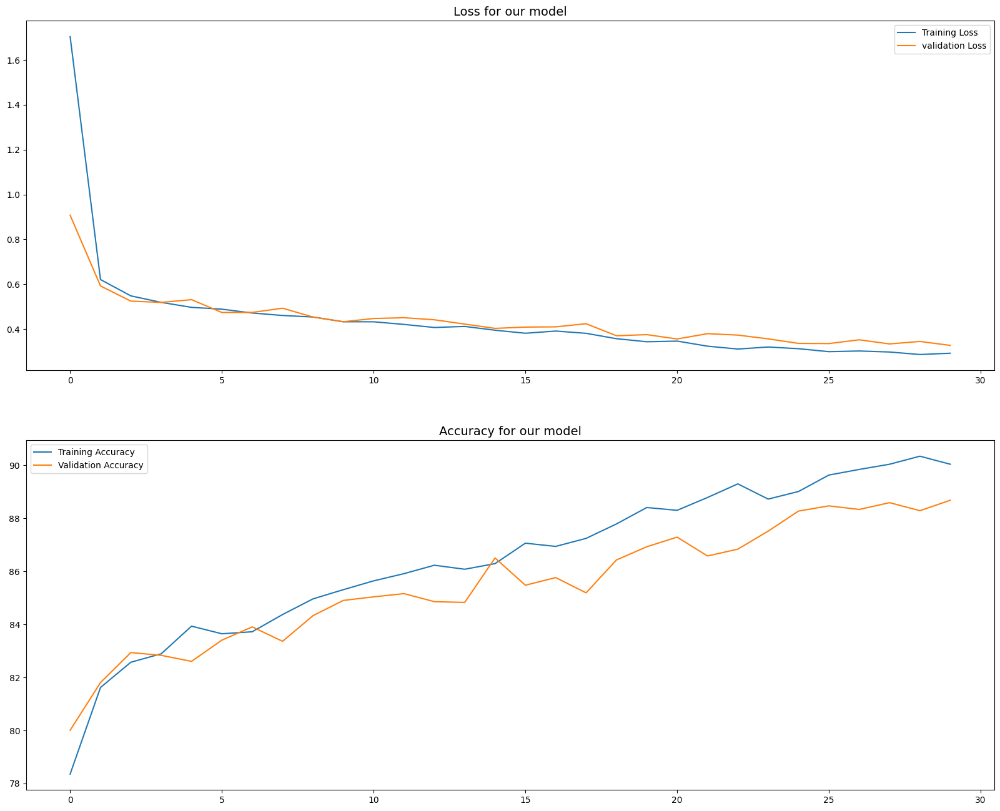

In [57]:
fig = plt.figure(num=2, figsize=(20, 16))
fig1 = fig.add_subplot(2, 1, 1)
fig2 = fig.add_subplot(2, 1, 2)

fig1.plot(total_loss_train, label = 'Training Loss')
fig1.plot(total_loss_val, label = 'validation Loss')
fig1.set_title('Loss for our model', fontsize = 14)
fig1.legend()
fig2.plot(total_acc_train, label = 'Training Accuracy')
fig2.plot(total_acc_val, label = 'Validation Accuracy')
fig2.set_title('Accuracy for our model', fontsize = 14)
fig2.legend()
plt.show()

In [58]:
# load the best model state into the CNN model
best_model_state = torch.load('CNN_model_unbalanced.pth', map_location = 'cpu')
CNN_model.load_state_dict(best_model_state)

CNN_model.to('cpu')

device = torch.device('cpu')
test_accuracy = test_model(CNN_model, test_loader, device)

print("------------------------------------------")
print(f"Best model\'s accuracy: {test_accuracy}")
print("------------------------------------------")


<ipython-input-58-396f0d9f8833>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load('CNN_model_unbalanced.pth', map_location = 'cpu')


------------------------------------------
Best model's accuracy: 88.0930794802055
------------------------------------------


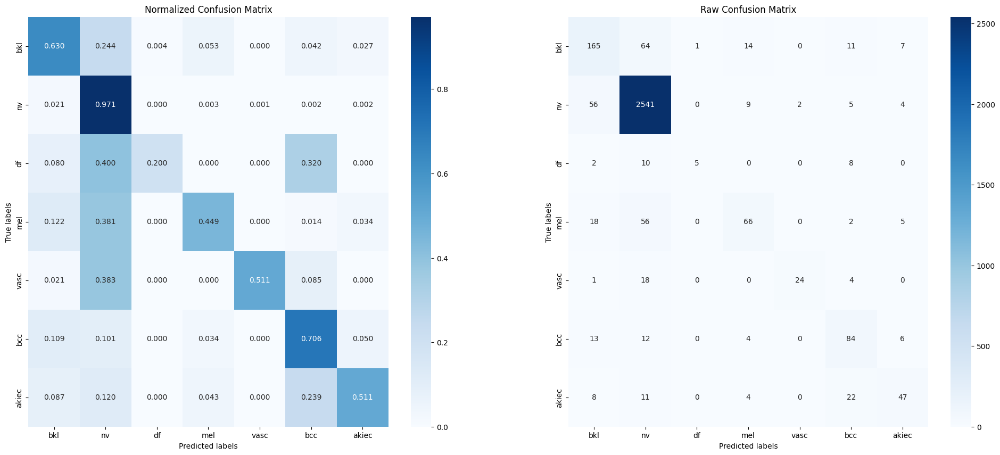

-------------------------------------------------------
Classification Report:

              precision    recall  f1-score   support

         bkl       0.63      0.63      0.63       262
          nv       0.94      0.97      0.95      2617
          df       0.83      0.20      0.32        25
         mel       0.68      0.45      0.54       147
        vasc       0.92      0.51      0.66        47
         bcc       0.62      0.71      0.66       119
       akiec       0.68      0.51      0.58        92

    accuracy                           0.89      3309
   macro avg       0.76      0.57      0.62      3309
weighted avg       0.88      0.89      0.88      3309

-------------------------------------------------------


In [59]:
conf_report(CNN_model, test_loader, 'CNN_unbalanced')

# Grad-CAM

Grad-CAM (Gradient-weighted Class Activation Mapping) is useful for CNN-based architectures. It highlights regions in the image that have the most influence on the model's predictions by utilizing the gradients of target concepts.

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


Class: 0


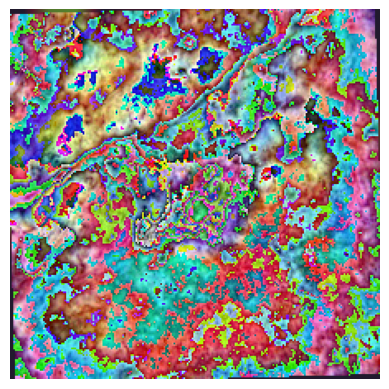

Class: 1


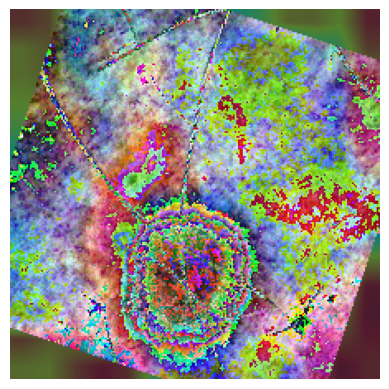

Class: 2


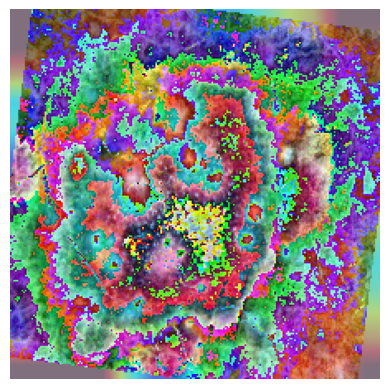

Class: 3


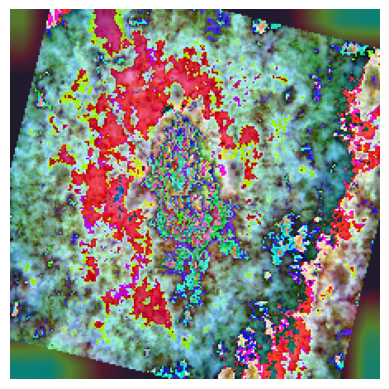

Class: 4


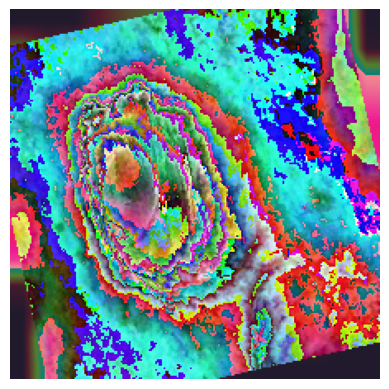

Class: 5


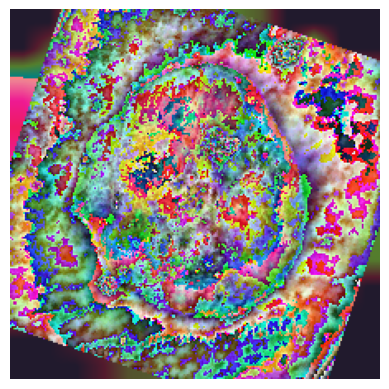

Class: 6


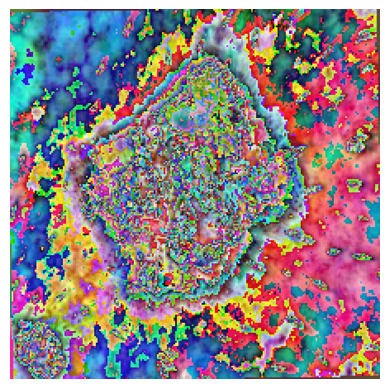

In [60]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import cv2
from torch.nn import functional as F

def grad_cam(model, image, target_class, last_conv_layer="layer4"):
    model.eval()
    gradients = []
    activations = []
    
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])
    
    def forward_hook(module, input, output):
        activations.append(output)
    
    # Register hooks
    last_conv = getattr(model, last_conv_layer)
    last_conv.register_forward_hook(forward_hook)
    last_conv.register_backward_hook(backward_hook)
    
    # Forward pass
    output = model(image)
    target = output[0, target_class]
    
    # Backward pass
    model.zero_grad()
    target.backward()
    
    # Get gradients and activations
    gradients_ = gradients[0].cpu().data.numpy()[0]
    activations_ = activations[0].cpu().data.numpy()[0]
    
    # Compute weights
    weights = np.mean(gradients_, axis=(1, 2))
    
    # Generate Grad-CAM heatmap
    cam = np.zeros(activations_.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * activations_[i]
    
    cam = np.maximum(cam, 0)  # ReLU
    cam = cam / cam.max()  # Normalize
    return cam

def overlay_heatmap(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    # Ensure `image` has the shape (3, H, W)
    if image.dim() == 4:
        image = image.squeeze(0)  # Remove the batch dimension if present
    
    # Convert heatmap to color map
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[2]))  # Use correct dimensions here
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, colormap)
    
    # Convert image to numpy array for visualization
    image_np = image.cpu().numpy().transpose(1, 2, 0) * 255
    superimposed_img = heatmap * alpha + image_np
    superimposed_img = np.uint8(superimposed_img)
    
    plt.imshow(superimposed_img)
    plt.axis('off')
    plt.show()

# Apply Grad-CAM to one sample per class
for target_class in range(7):  # Assuming classes are labeled from 0 to 6
    # Find an example of the target class in the test loader
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        idx = (labels == target_class).nonzero(as_tuple=True)[0]
        
        if len(idx) > 0:  # If we found an example
            image = images[idx[0]].unsqueeze(0)  # Select the first occurrence
            heatmap = grad_cam(CNN_model, image, target_class)
            print(f"Class: {target_class}")
            overlay_heatmap(image.squeeze(0), heatmap)
            break  # Move to the next class

### Last Convolutional Layers

Class: 0 - bkl


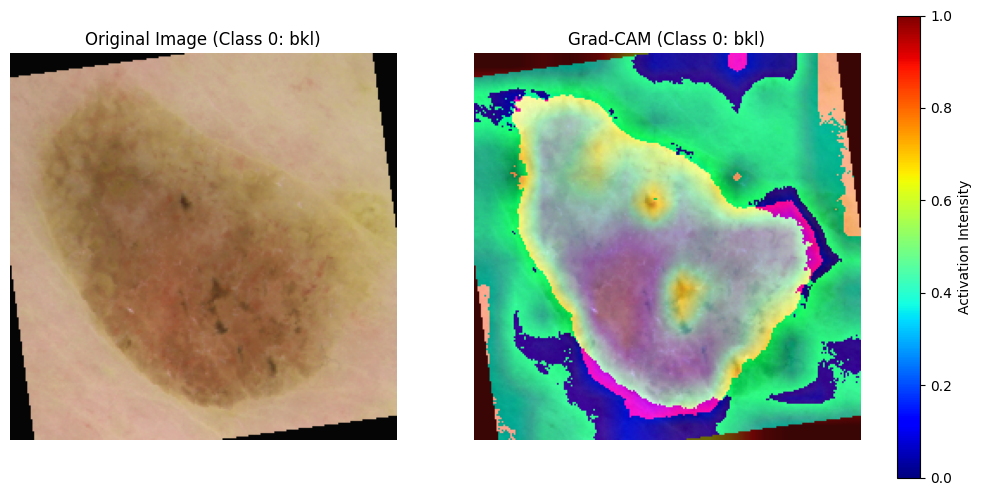

Class: 1 - nv


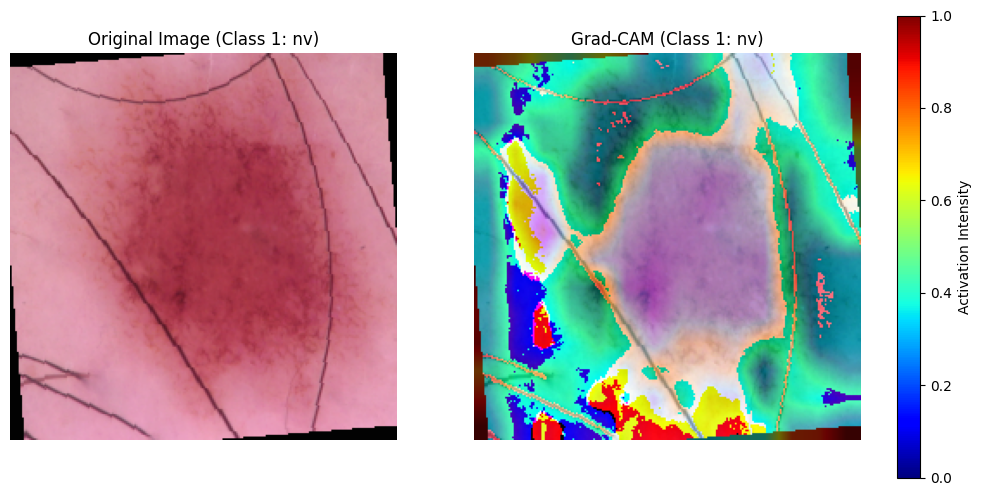

Class: 2 - df


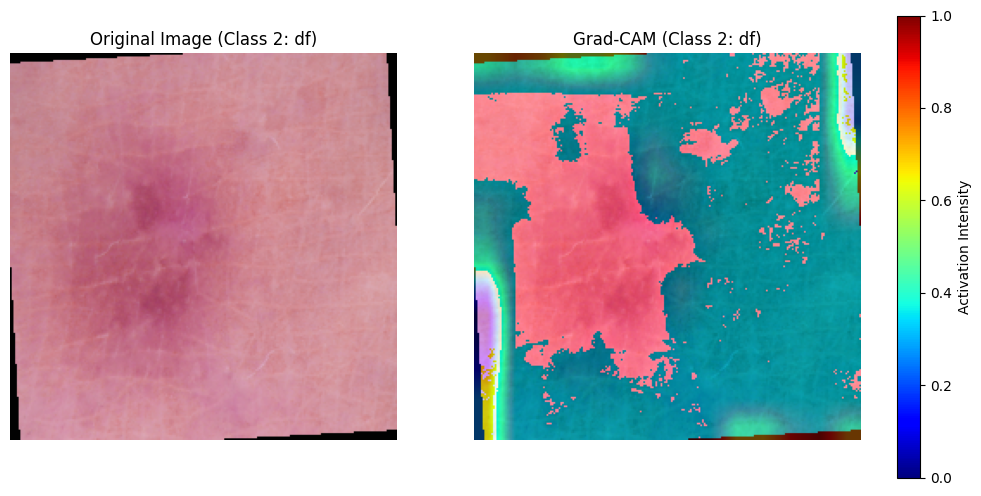

Class: 3 - mel


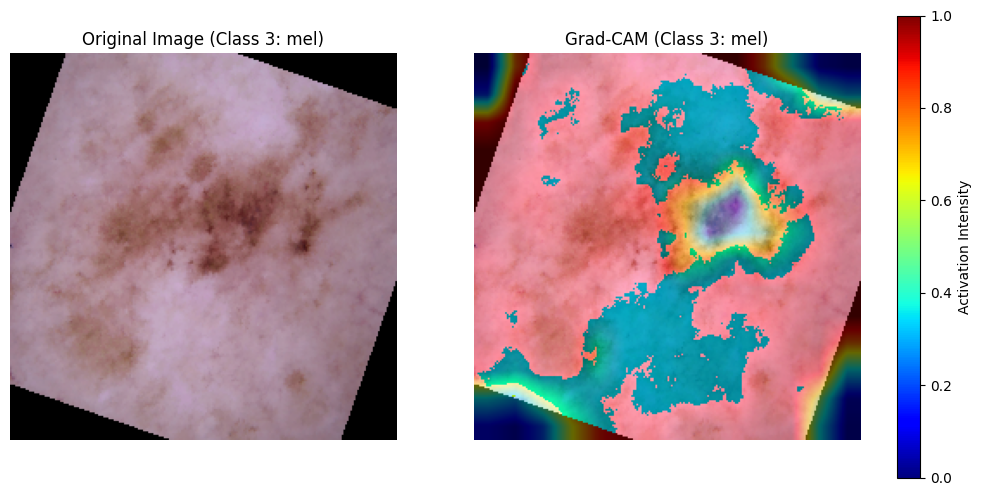

<ipython-input-61-eda1baaddb29>:44: RuntimeWarning: invalid value encountered in divide
  cam = cam / cam.max()  # Normalize
<ipython-input-61-eda1baaddb29>:53: RuntimeWarning: invalid value encountered in cast
  heatmap = np.uint8(255 * heatmap)


Class: 4 - vasc


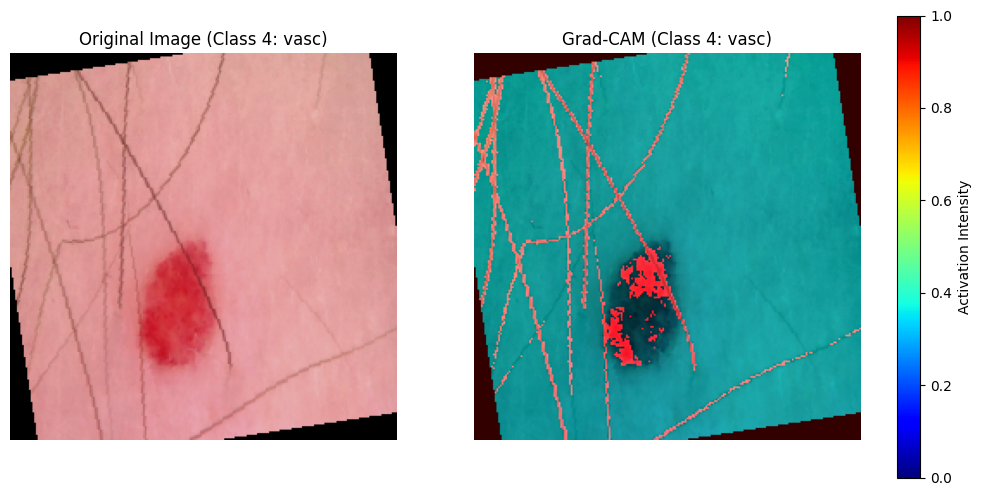

Class: 5 - bcc


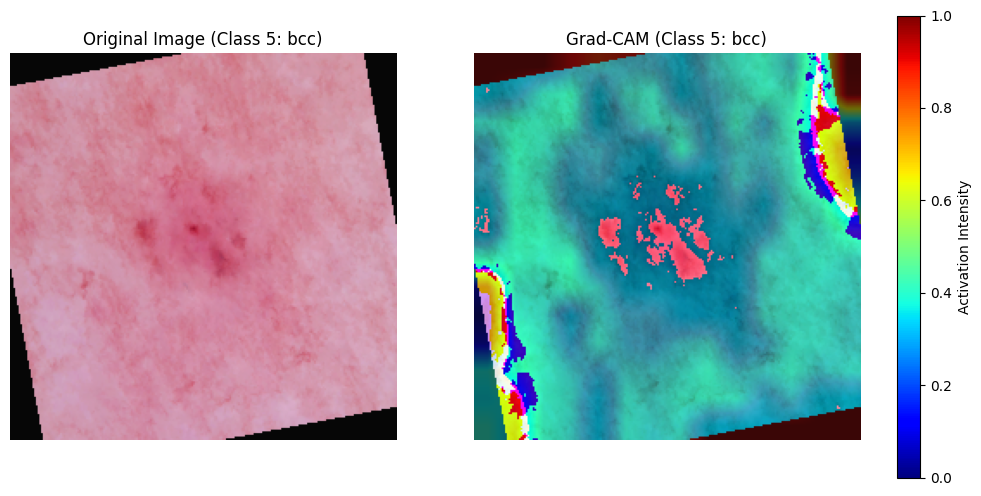

Class: 6 - akiec


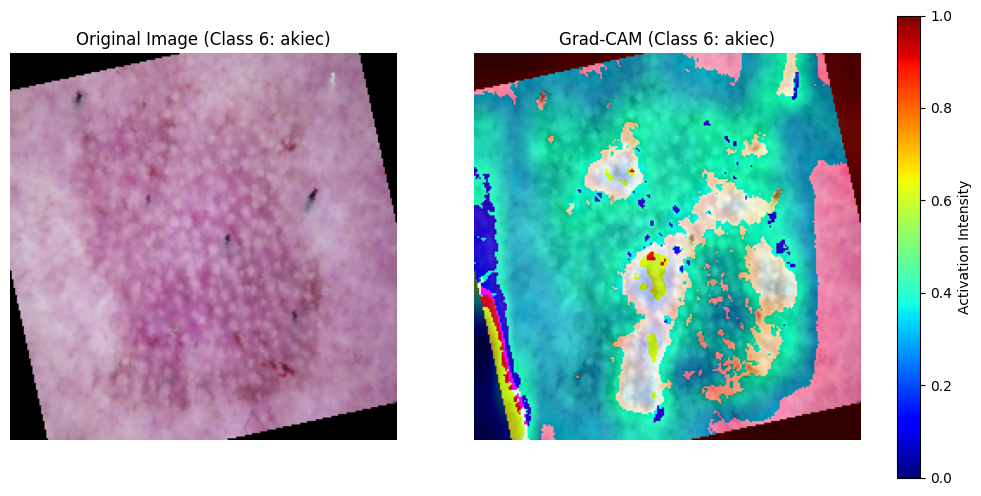

In [61]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import cv2
from torch.nn import functional as F

def grad_cam(model, image, target_class, last_conv_layer="layer4"):
    model.eval()
    gradients = []
    activations = []
    
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])
    
    def forward_hook(module, input, output):
        activations.append(output)
    
    # Register hooks
    last_conv = getattr(model, last_conv_layer)
    last_conv.register_forward_hook(forward_hook)
    last_conv.register_backward_hook(backward_hook)
    
    # Forward pass
    output = model(image)
    target = output[0, target_class]
    
    # Backward pass
    model.zero_grad()
    target.backward()
    
    # Get gradients and activations
    gradients_ = gradients[0].cpu().data.numpy()[0]
    activations_ = activations[0].cpu().data.numpy()[0]
    
    # Compute weights
    weights = np.mean(gradients_, axis=(1, 2))
    
    # Generate Grad-CAM heatmap
    cam = np.zeros(activations_.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * activations_[i]
    
    cam = np.maximum(cam, 0)  # ReLU
    cam = cam / cam.max()  # Normalize
    return cam

def overlay_heatmap(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    if image.dim() == 4:
        image = image.squeeze(0)  # Remove batch dimension if present
    
    # Resize heatmap to match image size and apply color map
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[2]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, colormap)
    
    # Convert image tensor to numpy for overlay
    image_np = image.cpu().numpy().transpose(1, 2, 0) * 255
    superimposed_img = heatmap * alpha + image_np
    superimposed_img = np.uint8(superimposed_img)
    
    return image_np, superimposed_img

def reverse_normalization(image, mean, std):
    for i in range(3):  # Assuming 3 channels (RGB)
        image[i] = image[i] * std[i] + mean[i]
    return image


# Define the class mapping
class_labels = {
    'bkl': 0,
    'nv': 1,
    'df': 2,
    'mel': 3,
    'vasc': 4,
    'bcc': 5,
    'akiec': 6
}

# Reverse mapping for easy lookup by index
index_to_class = {v: k for k, v in class_labels.items()}

def display_grad_cam(image, heatmap, target_class):
    # Reverse normalization for visualization
    mean = [0.77148203, 0.55764165, 0.58345652]
    std = [0.12655577, 0.14245141, 0.15189891]
    image = reverse_normalization(image.clone(), mean, std)

    # Overlay original and heatmap
    original_img, grad_cam_img = overlay_heatmap(image, heatmap)

    # Retrieve class name using target_class
    class_name = index_to_class.get(target_class, "Unknown")

    # Create figure with a color bar
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(original_img.astype(np.uint8))
    ax[0].set_title(f"Original Image (Class {target_class}: {class_name})")
    ax[0].axis('off')
    
    ax[1].imshow(grad_cam_img)
    ax[1].set_title(f"Grad-CAM (Class {target_class}: {class_name})")
    ax[1].axis('off')
    
    # Add color bar for significance of the colors
    colorbar_img = plt.cm.ScalarMappable(cmap='jet')
    plt.colorbar(colorbar_img, ax=ax, orientation='vertical', fraction=0.046, pad=0.04, label='Activation Intensity')
    plt.show()

# Loop through each class and apply Grad-CAM on a random image
for target_class in range(7):  # Assuming classes are labeled from 0 to 6
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if target_images:
        # Select a random image from the target class
        image = random.choice(target_images)
        heatmap = grad_cam(CNN_model, image, target_class)
        print(f"Class: {target_class} - {index_to_class[target_class]}")
        display_grad_cam(image.squeeze(0), heatmap, target_class)



Class 0 - bkl


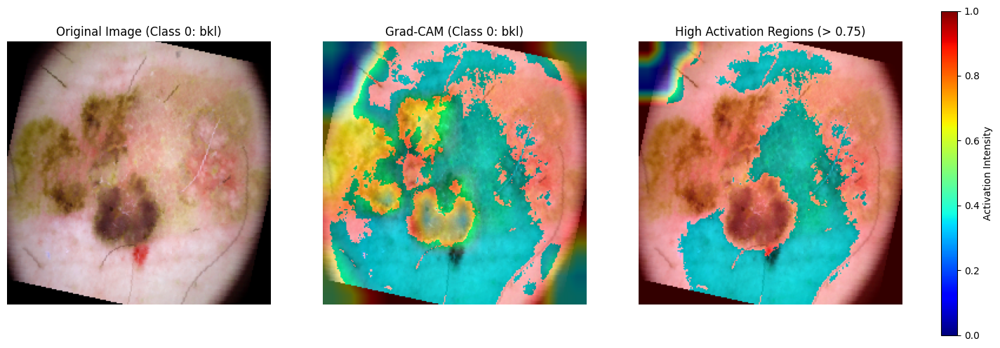

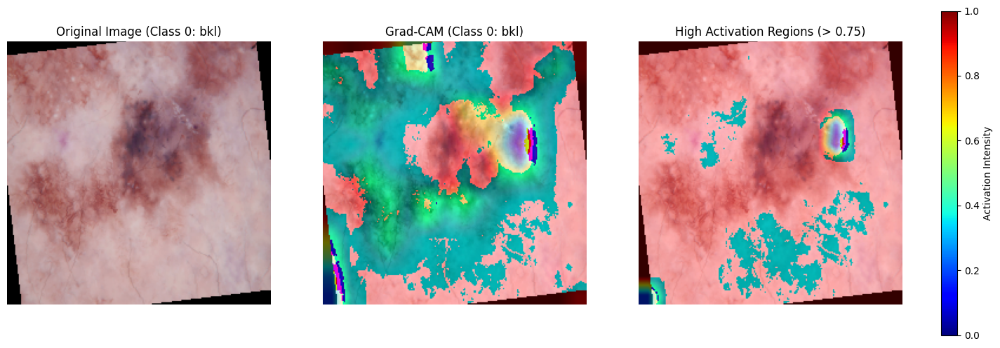

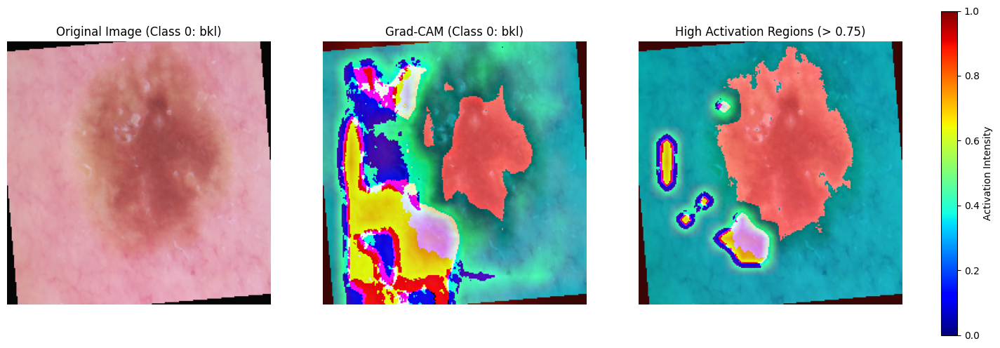

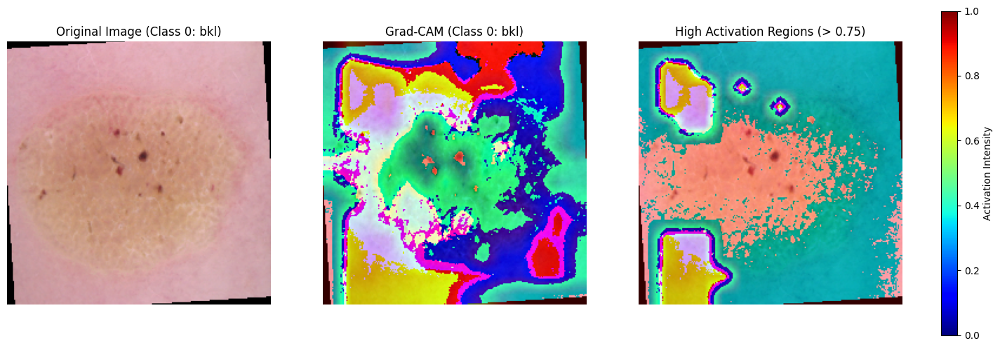


Class 1 - nv


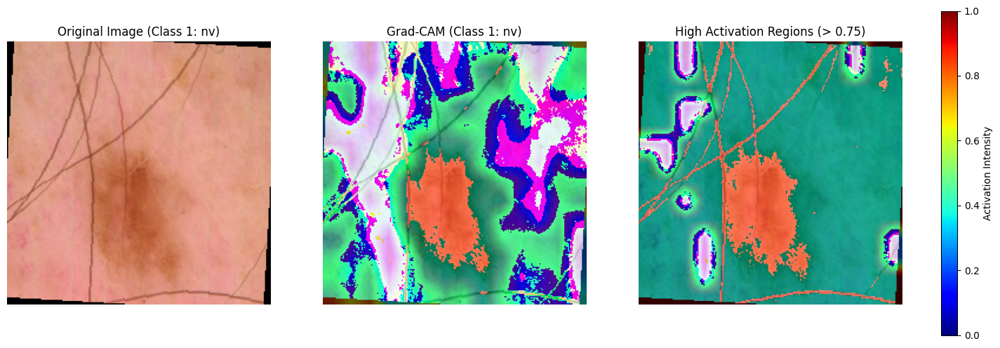

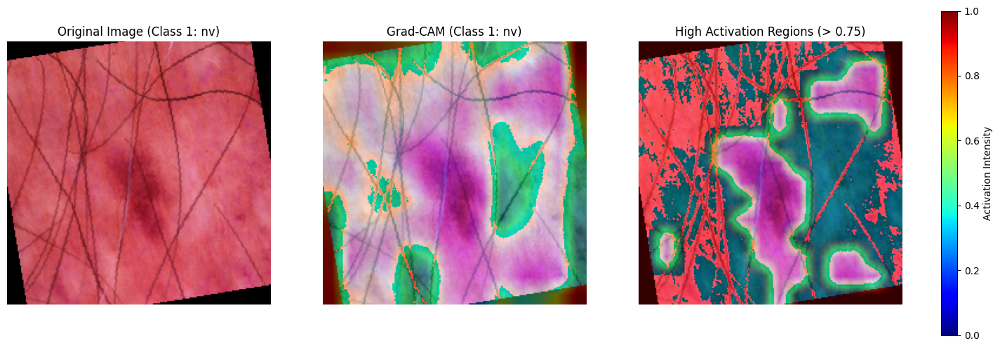

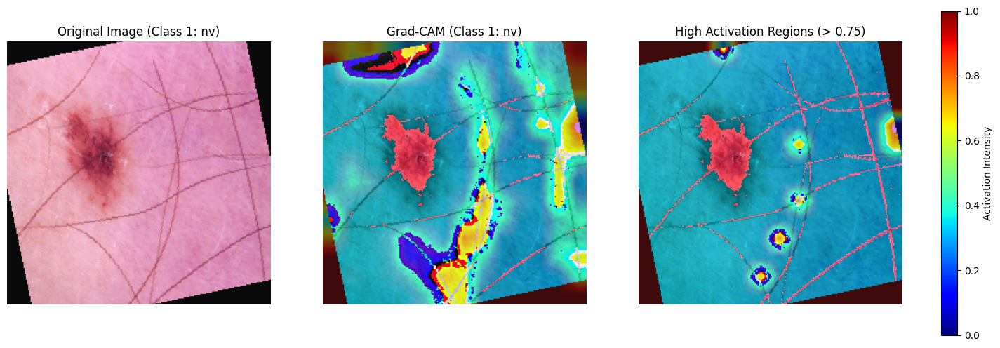

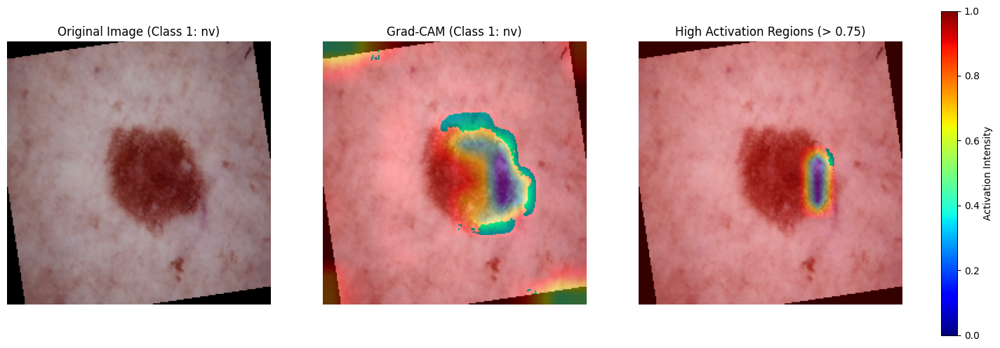


Class 2 - df


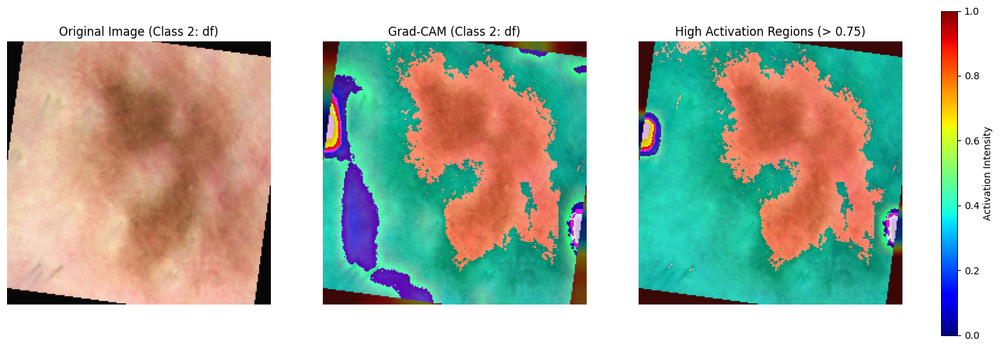

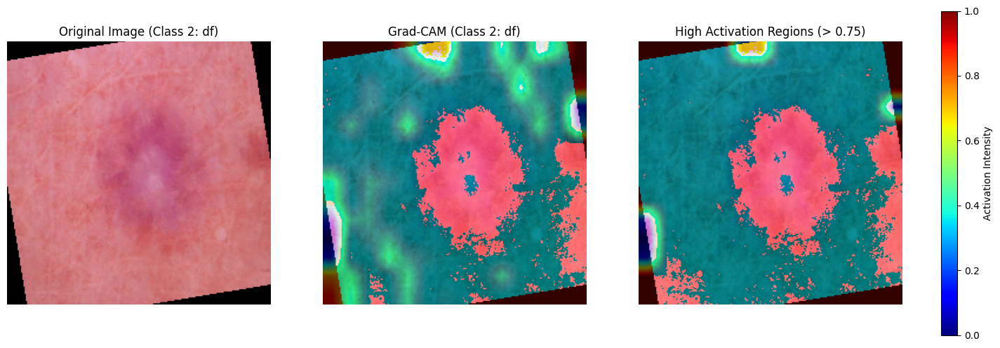

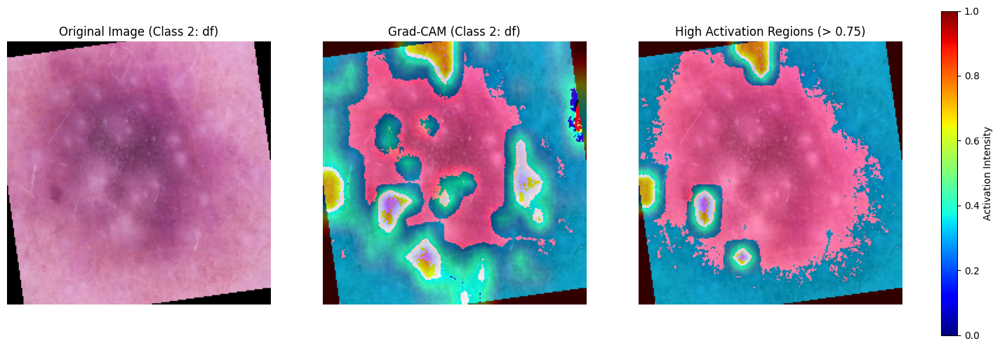

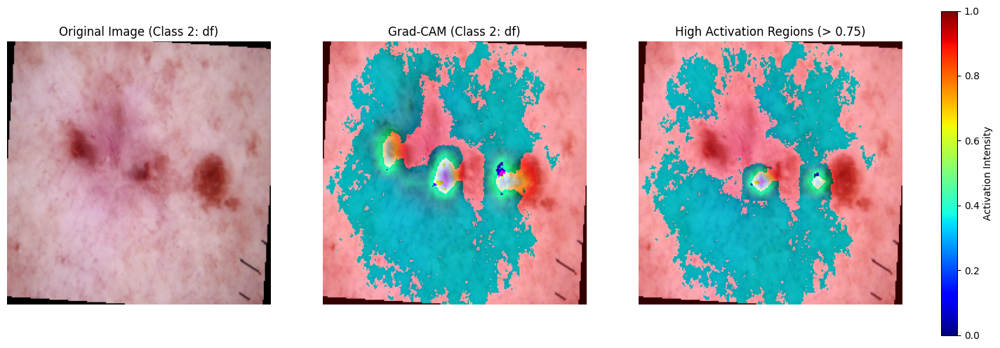


Class 3 - mel


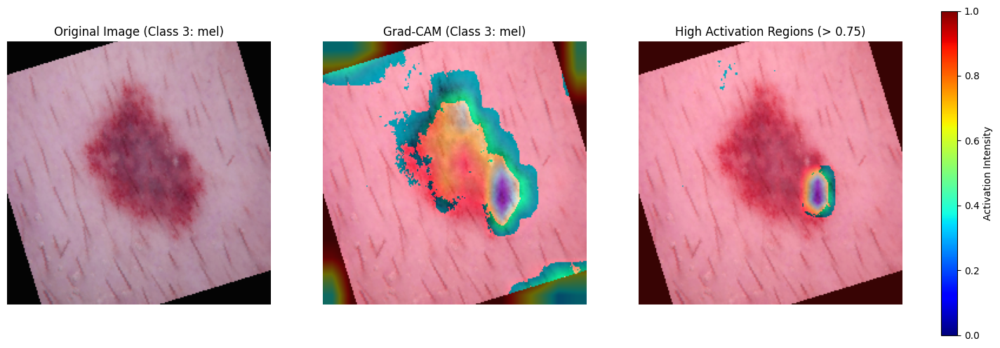

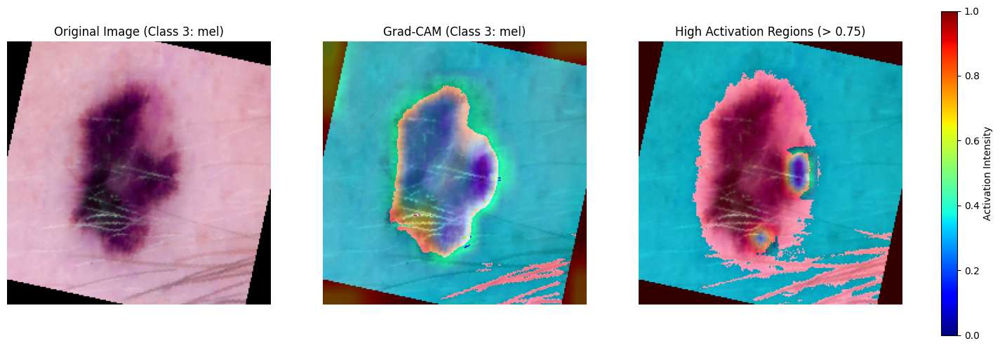

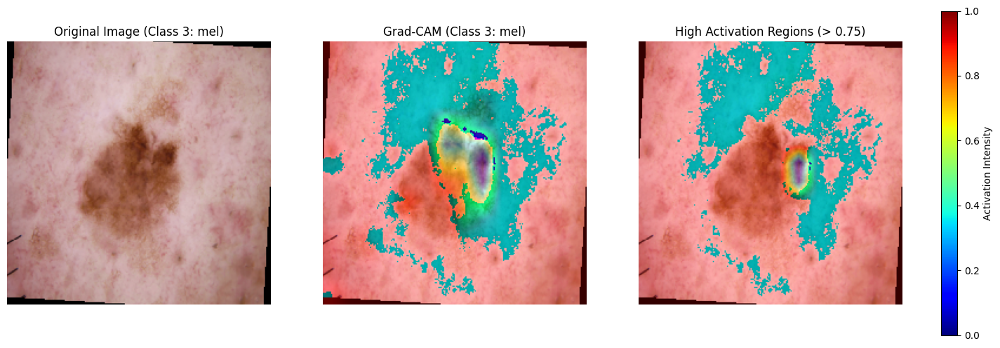

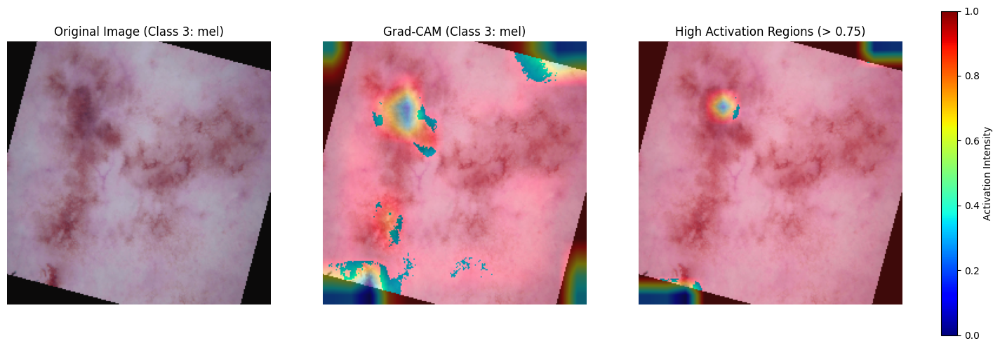


Class 4 - vasc


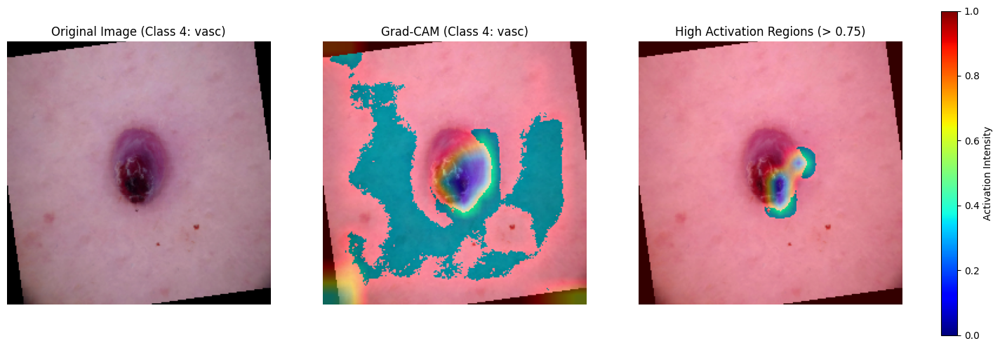

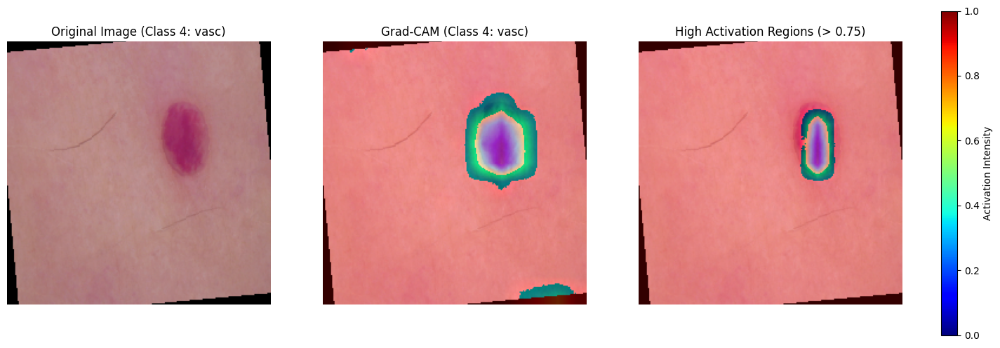

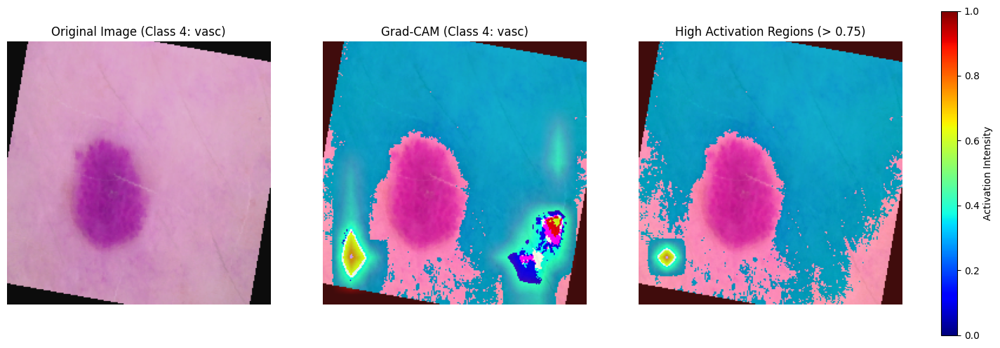

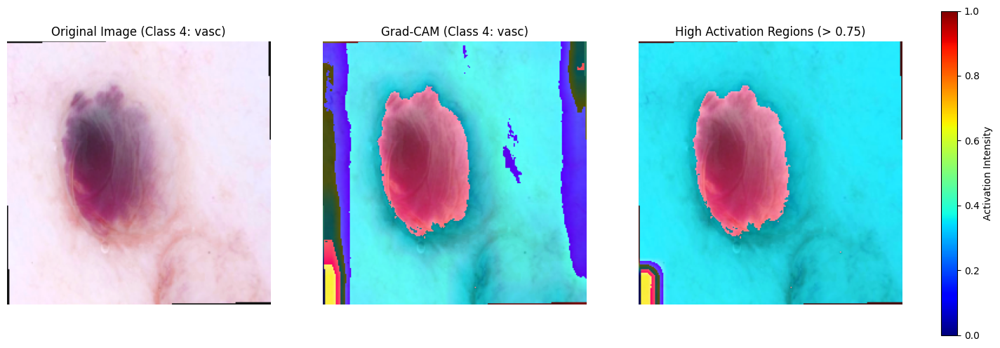


Class 5 - bcc


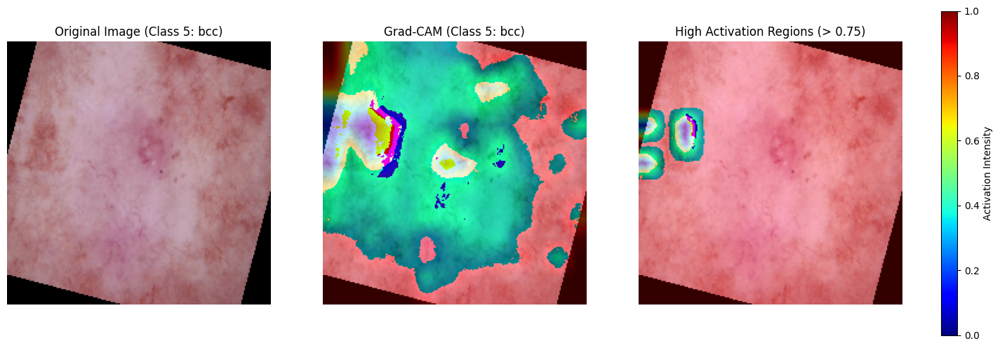

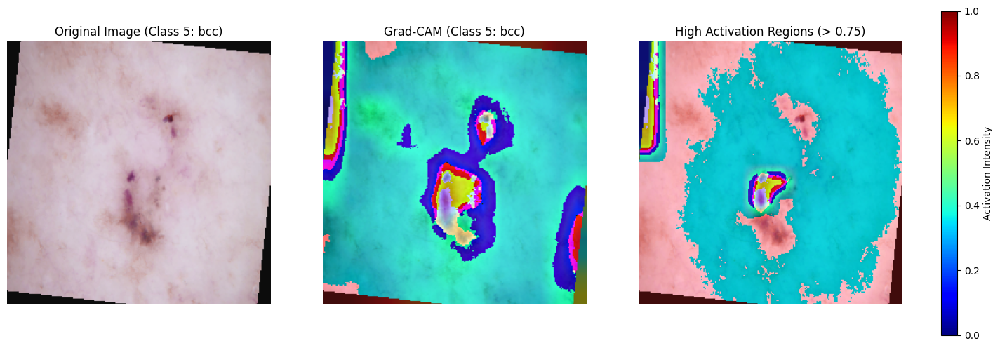

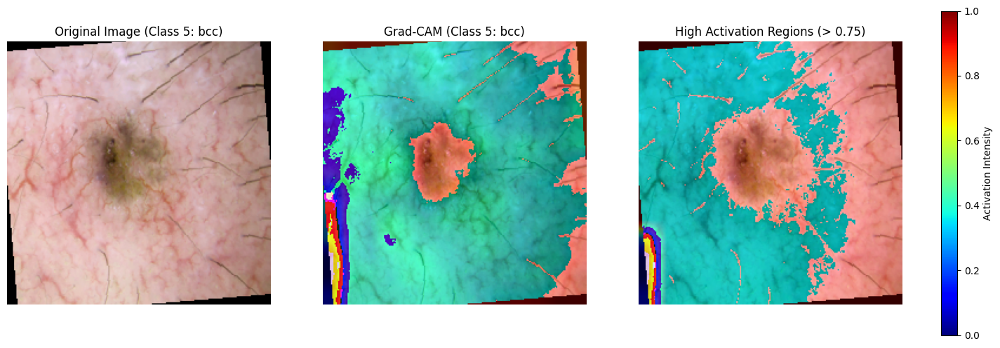

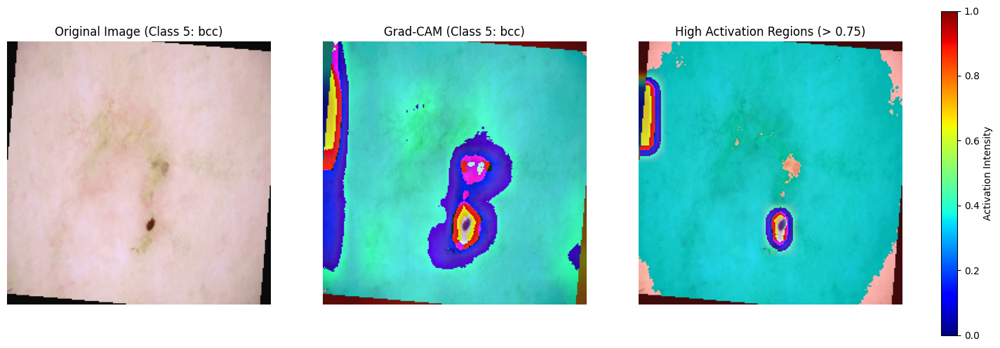


Class 6 - akiec


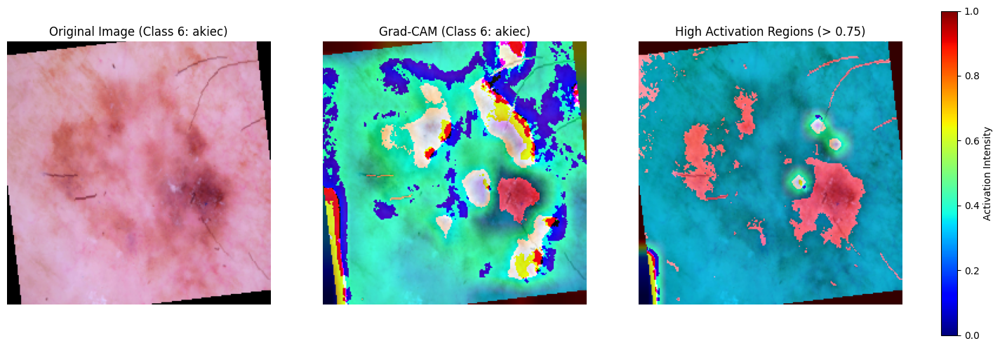

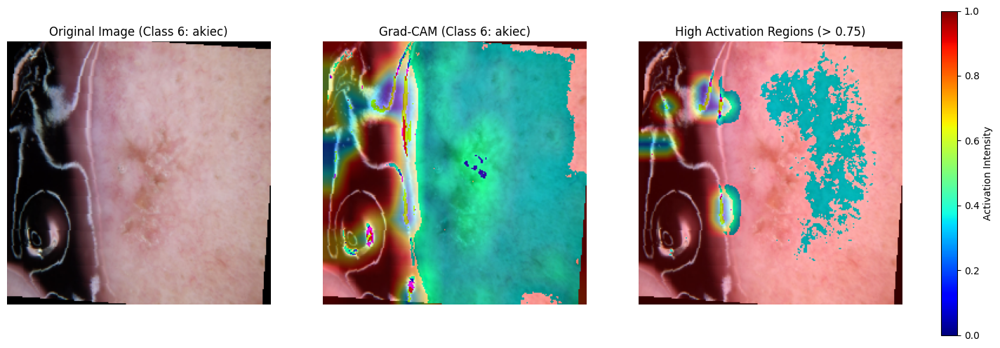

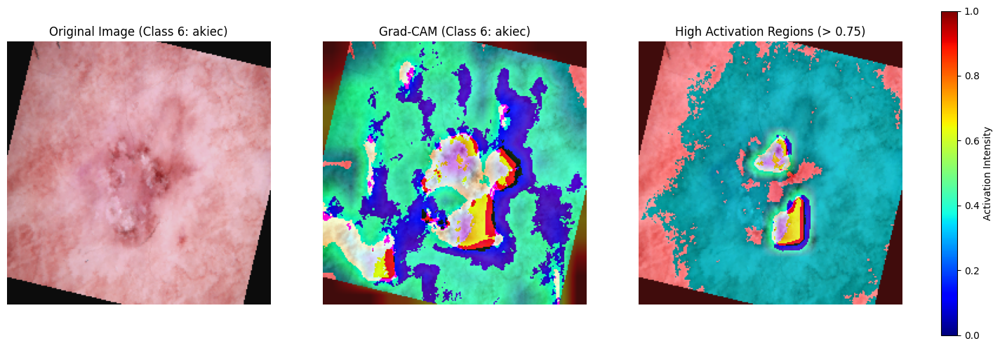

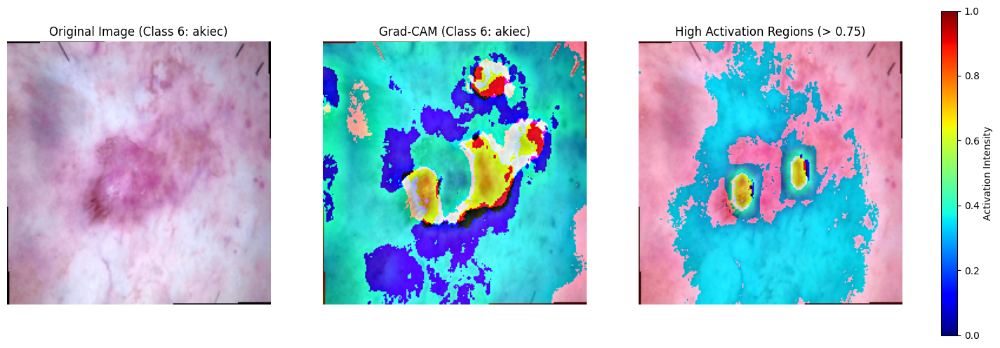

In [62]:
import random

# Define the class mapping
class_labels = {
    'bkl': 0,
    'nv': 1,
    'df': 2,
    'mel': 3,
    'vasc': 4,
    'bcc': 5,
    'akiec': 6
}

# Reverse mapping for easy lookup by index
index_to_class = {v: k for k, v in class_labels.items()}

def display_grad_cam_with_threshold(image, heatmap, target_class):
    # Reverse normalization for visualization
    mean = [0.77148203, 0.55764165, 0.58345652]
    std = [0.12655577, 0.14245141, 0.15189891]
    image = reverse_normalization(image.clone(), mean, std)

    # Overlay original and heatmap
    original_img, grad_cam_img = overlay_heatmap(image, heatmap)

    # Apply thresholding to show only high-activation regions
    thresholded_heatmap = heatmap.copy()
    thresholded_heatmap[thresholded_heatmap < 0.75] = 0  # Mask out areas below 0.75
    thresholded_heatmap = cv2.resize(thresholded_heatmap, (image.shape[1], image.shape[2]))
    thresholded_heatmap = np.uint8(255 * thresholded_heatmap)
    thresholded_heatmap = cv2.applyColorMap(thresholded_heatmap, cv2.COLORMAP_JET)

    # Combine thresholded heatmap with the original image for display
    highlighted_img = thresholded_heatmap * 0.4 + original_img

    # Retrieve class name using target_class
    class_name = index_to_class.get(target_class, "Unknown")

    # Create figure with color bar
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))
    ax[0].imshow(original_img.astype(np.uint8))
    ax[0].set_title(f"Original Image (Class {target_class}: {class_name})")
    ax[0].axis('off')
    
    ax[1].imshow(grad_cam_img)
    ax[1].set_title(f"Grad-CAM (Class {target_class}: {class_name})")
    ax[1].axis('off')
    
    ax[2].imshow(highlighted_img.astype(np.uint8))
    ax[2].set_title("High Activation Regions (> 0.75)")
    ax[2].axis('off')
    
    # Add color bar for significance of the colors
    colorbar_img = plt.cm.ScalarMappable(cmap='jet')
    plt.colorbar(colorbar_img, ax=ax, orientation='vertical', fraction=0.046, pad=0.04, label='Activation Intensity')
    plt.show()

# Loop through each class and apply Grad-CAM on 4 random images
for target_class in range(7):  # Assuming classes are labeled from 0 to 6
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if len(target_images) >= 4:
        # Select 4 random images from the target class
        selected_images = random.sample(target_images, 4)
        print(f"\nClass {target_class} - {index_to_class[target_class]}")
        
        for image in selected_images:
            heatmap = grad_cam(CNN_model, image, target_class)
            display_grad_cam_with_threshold(image.squeeze(0), heatmap, target_class)


## Early and Intermediate Convolutional Layers

In [63]:
import random
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt

def grad_cam_layer(model, image, target_class, target_layer):
    model.eval()
    gradients = []
    activations = []
    
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])
    
    def forward_hook(module, input, output):
        activations.append(output)
    
    # Register hooks on the specified layer
    layer = getattr(model, target_layer)
    layer.register_forward_hook(forward_hook)
    layer.register_backward_hook(backward_hook)
    
    # Forward pass
    output = model(image)
    target = output[0, target_class]
    
    # Backward pass
    model.zero_grad()
    target.backward()
    
    # Get gradients and activations
    gradients_ = gradients[0].cpu().data.numpy()[0]
    activations_ = activations[0].cpu().data.numpy()[0]
    
    # Compute weights
    weights = np.mean(gradients_, axis=(1, 2))
    
    # Generate Grad-CAM heatmap
    cam = np.zeros(activations_.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * activations_[i]
    
    # Safe normalization
    if cam.max() > 0:
        cam = cam / cam.max()  # Normalize only if max value is non-zero
    else:
        cam = np.zeros_like(cam)  # Set to zeros if normalization is not possible
    
    return cam

def display_grad_cam_layer(image, heatmap, layer_name, target_class, class_name):
    # Reverse normalization for visualization
    mean = [0.77148203, 0.55764165, 0.58345652]
    std = [0.12655577, 0.14245141, 0.15189891]
    image = reverse_normalization(image.clone(), mean, std)

    # Overlay original and heatmap
    original_img, grad_cam_img = overlay_heatmap(image, heatmap)

    # Create figure
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(original_img.astype(np.uint8))
    ax[0].set_title(f"Original Image (Class {target_class}: {class_name})")
    ax[0].axis('off')
    
    ax[1].imshow(grad_cam_img)
    ax[1].set_title(f"Grad-CAM at {layer_name} (Class {target_class}: {class_name})")
    ax[1].axis('off')
    
    plt.show()


## Grad-CAM for Early Layer


Class 0 - bkl


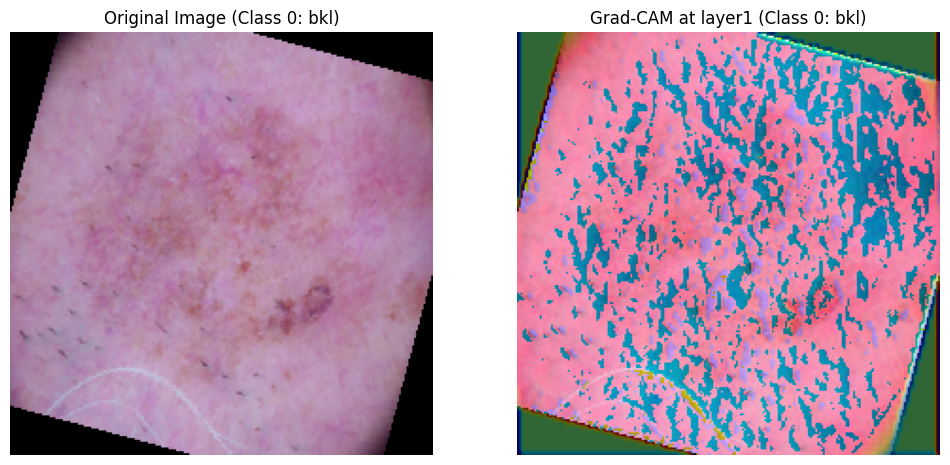

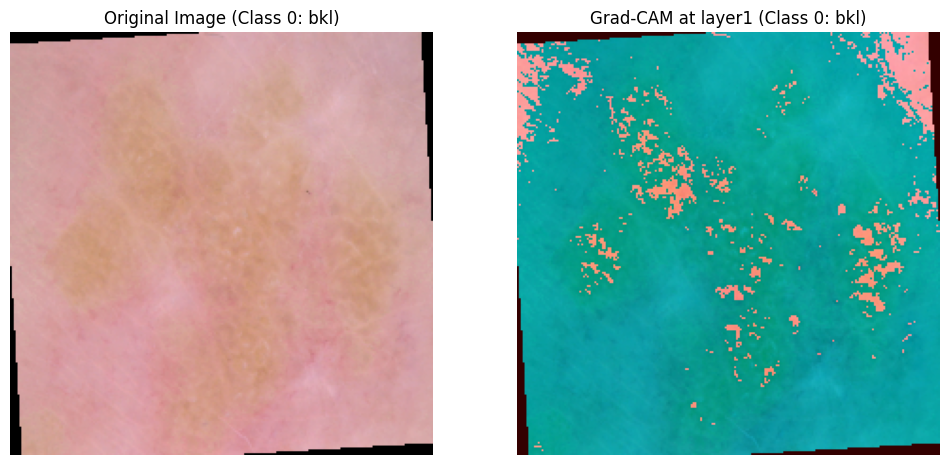


Class 1 - nv


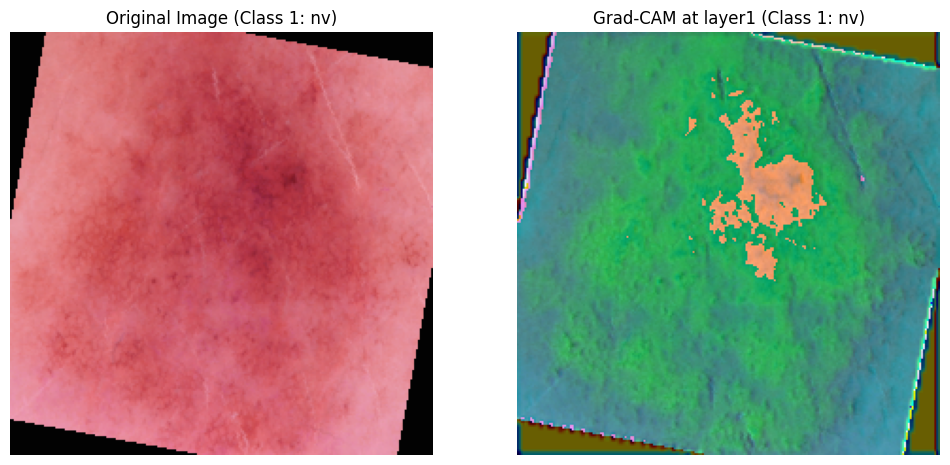

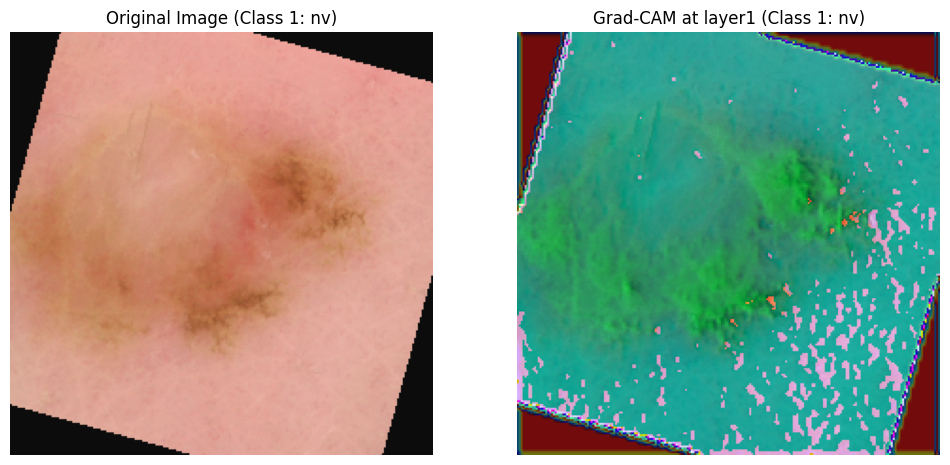


Class 2 - df


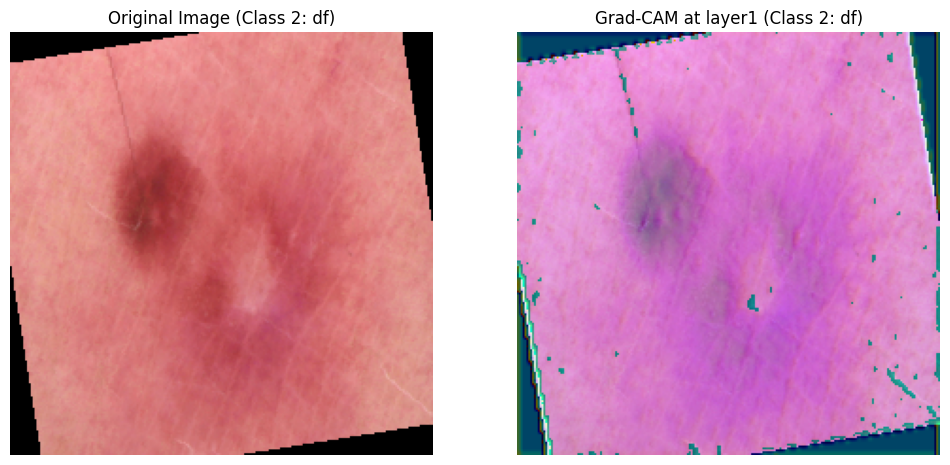

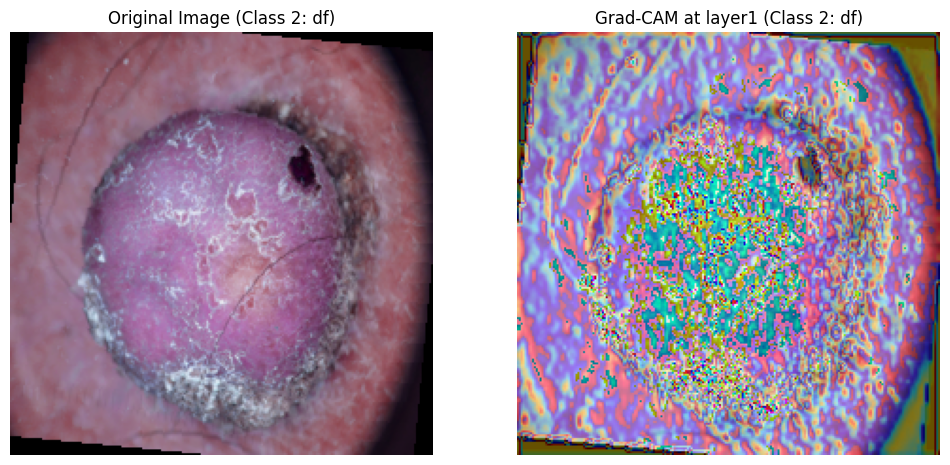


Class 3 - mel


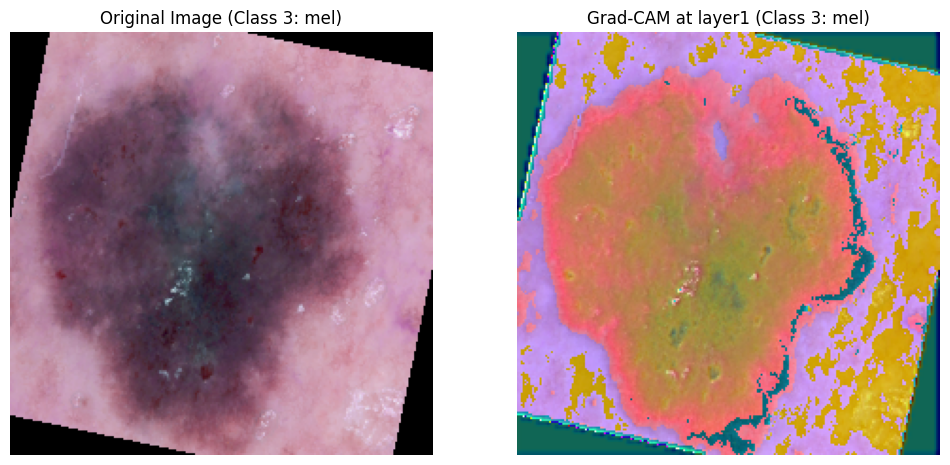

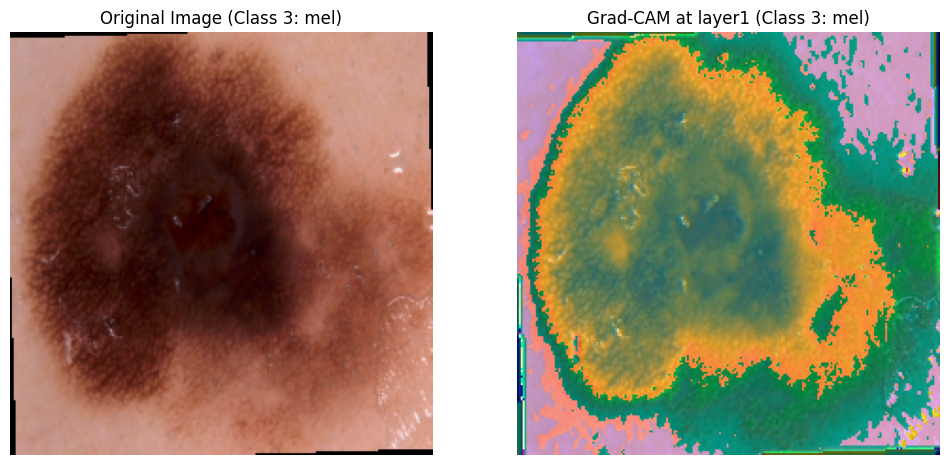


Class 4 - vasc


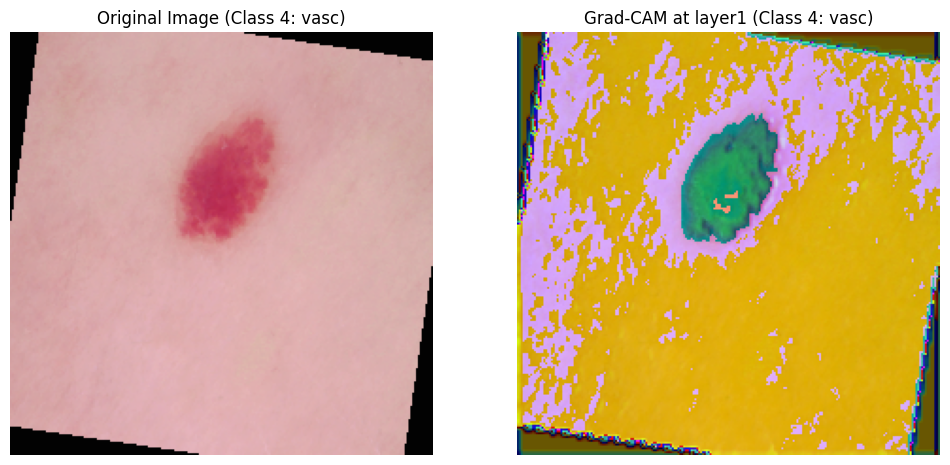

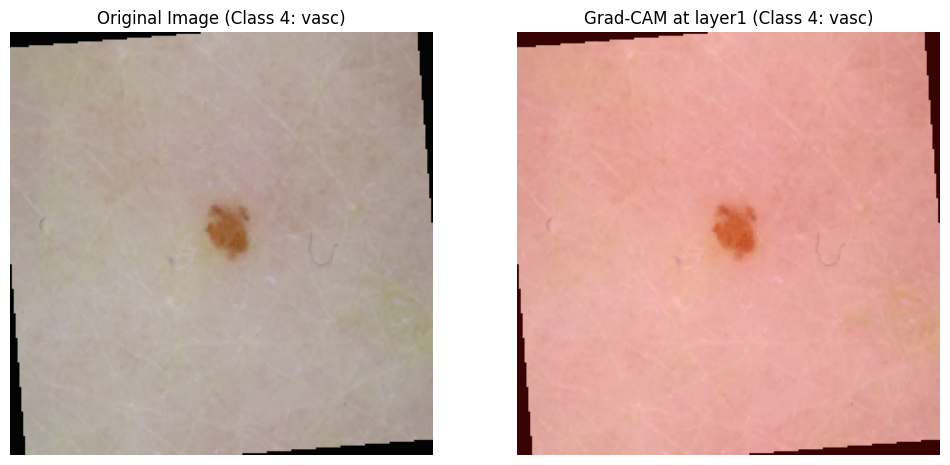


Class 5 - bcc


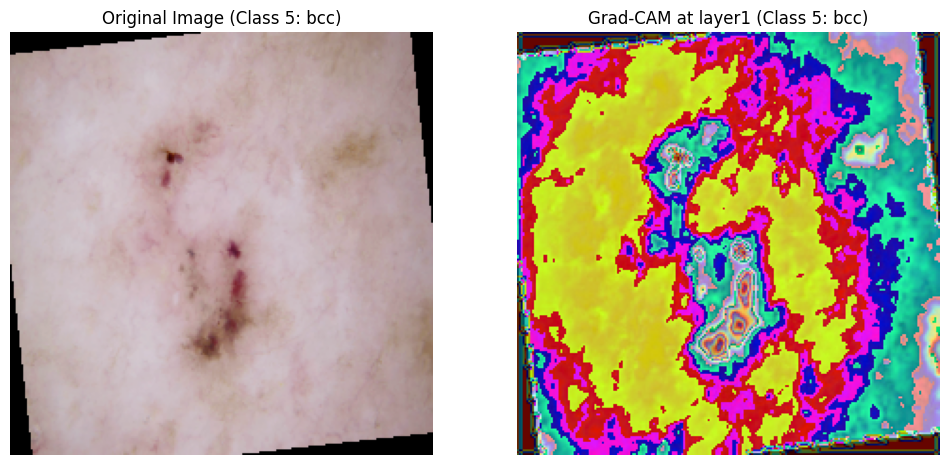

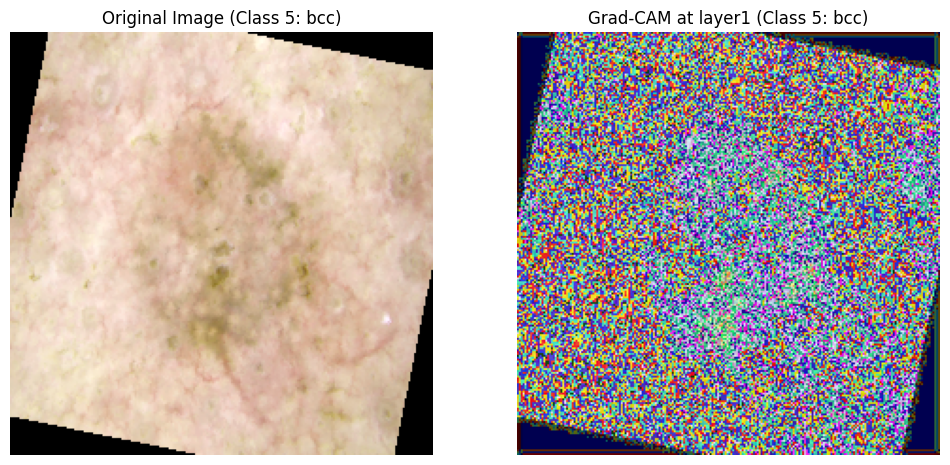


Class 6 - akiec


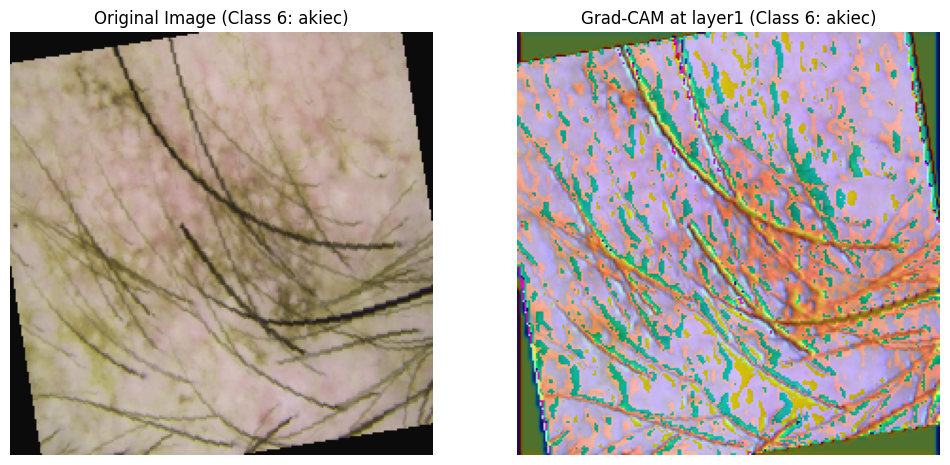

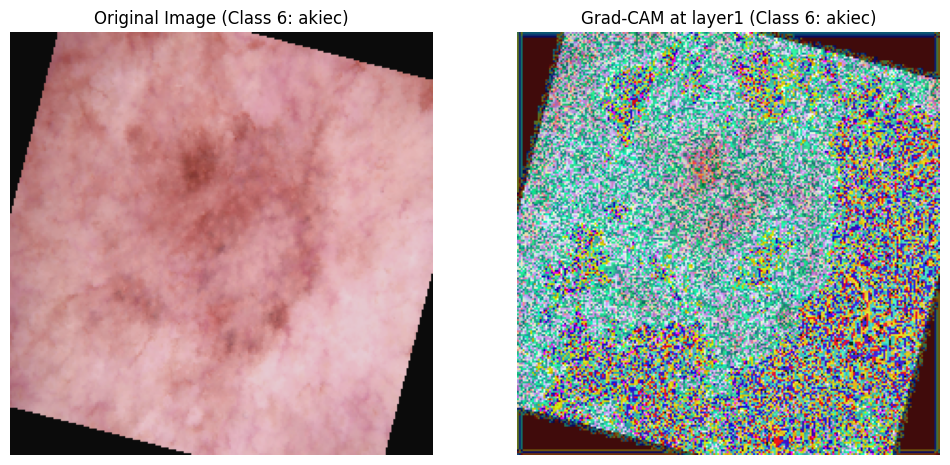

In [64]:
# Define the class mapping
class_labels = {
    'bkl': 0,
    'nv': 1,
    'df': 2,
    'mel': 3,
    'vasc': 4,
    'bcc': 5,
    'akiec': 6
}

# Reverse mapping for easy lookup by index
index_to_class = {v: k for k, v in class_labels.items()}

# Loop through each class and apply Grad-CAM on 2 random images at early layer
for target_class in range(7):
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if len(target_images) >= 2:
        selected_images = random.sample(target_images, 2)
        class_name = index_to_class[target_class]
        
        print(f"\nClass {target_class} - {class_name}")
        
        for image in selected_images:
            heatmap = grad_cam_layer(CNN_model, image, target_class, "layer1")
            display_grad_cam_layer(image.squeeze(0), heatmap, "layer1", target_class, class_name)


## Grad-CAM for Intermediate Layer


Class 0 - bkl


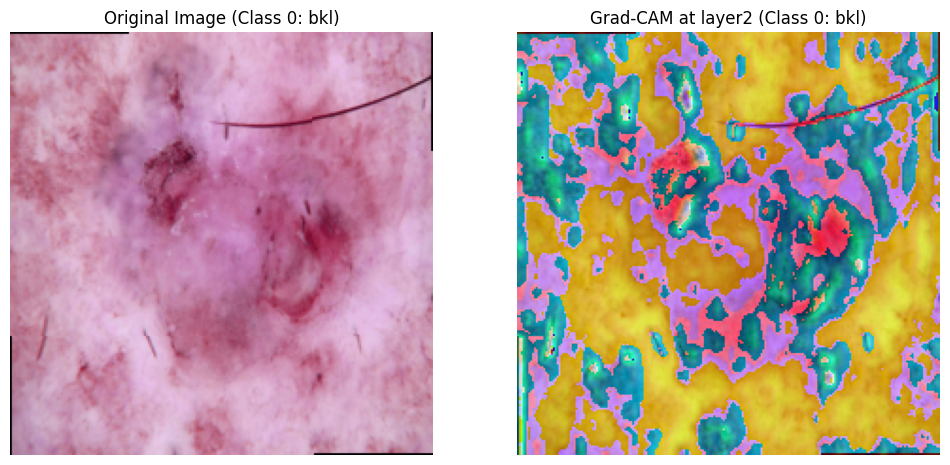

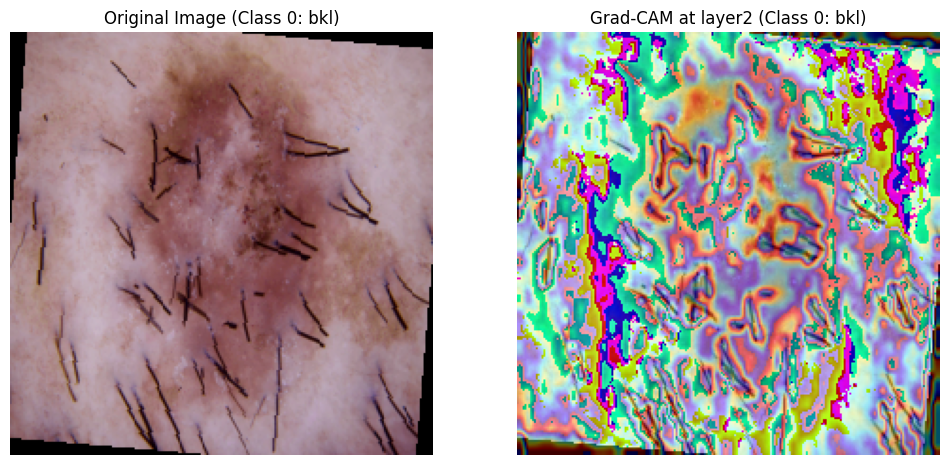


Class 1 - nv


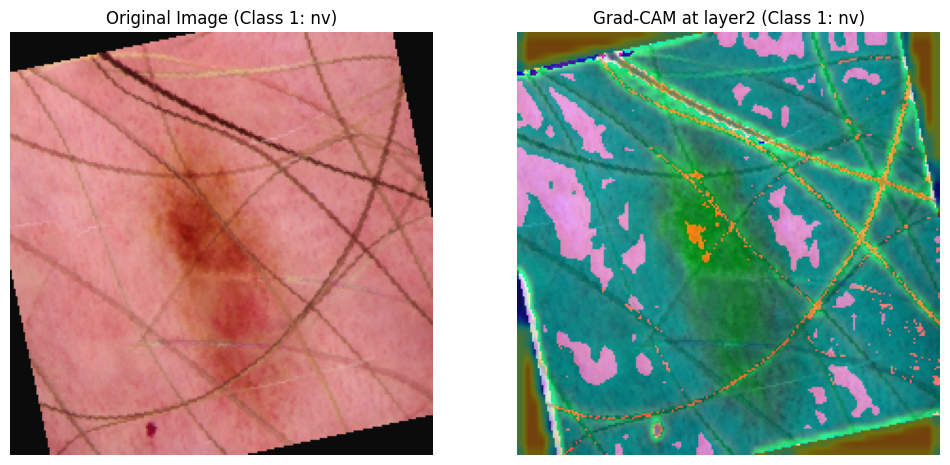

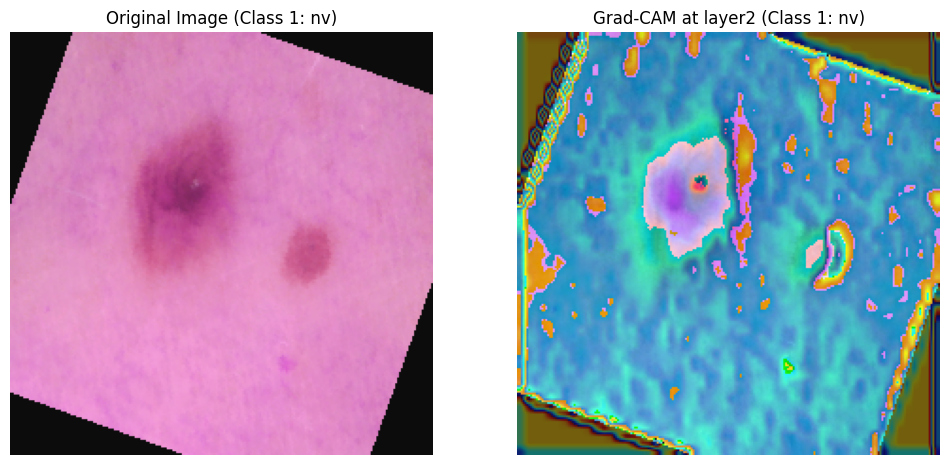


Class 2 - df


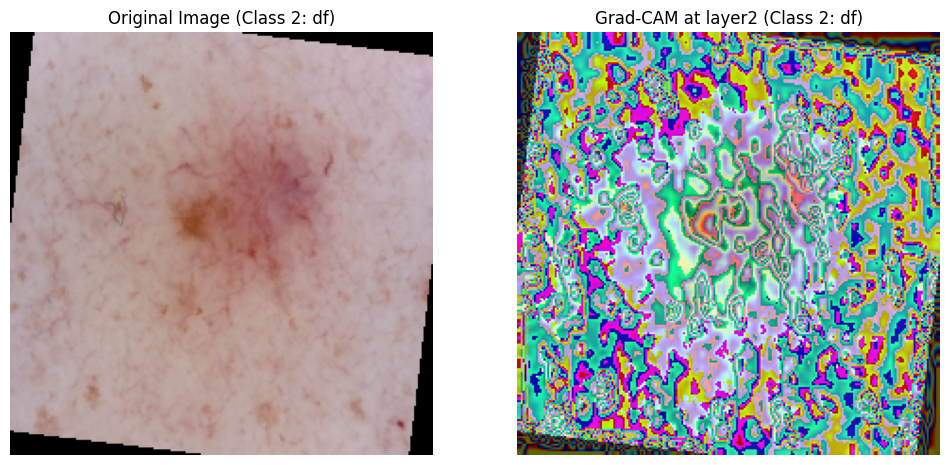

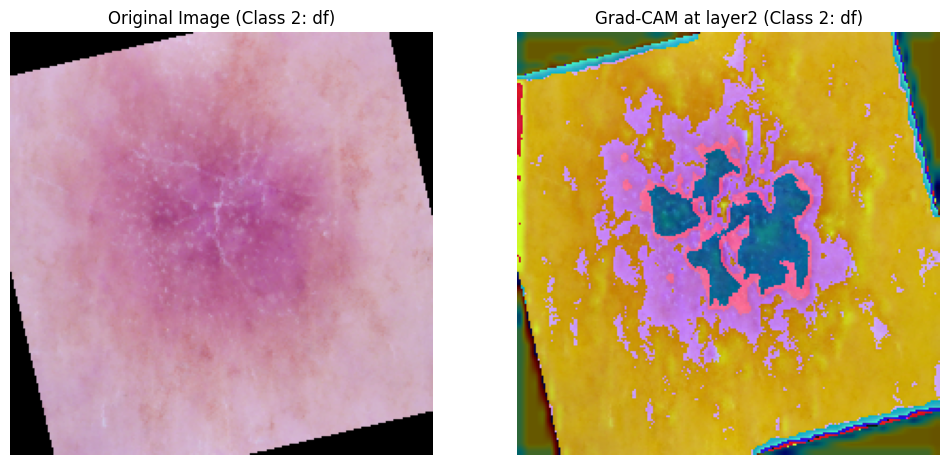


Class 3 - mel


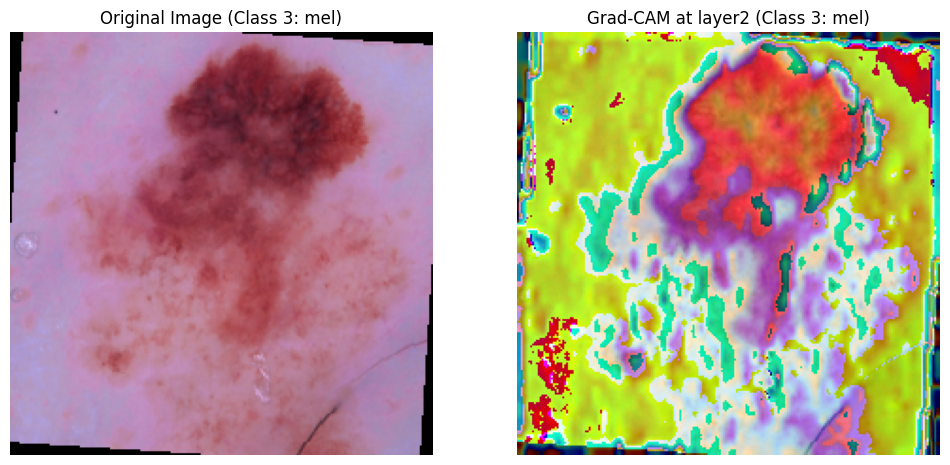

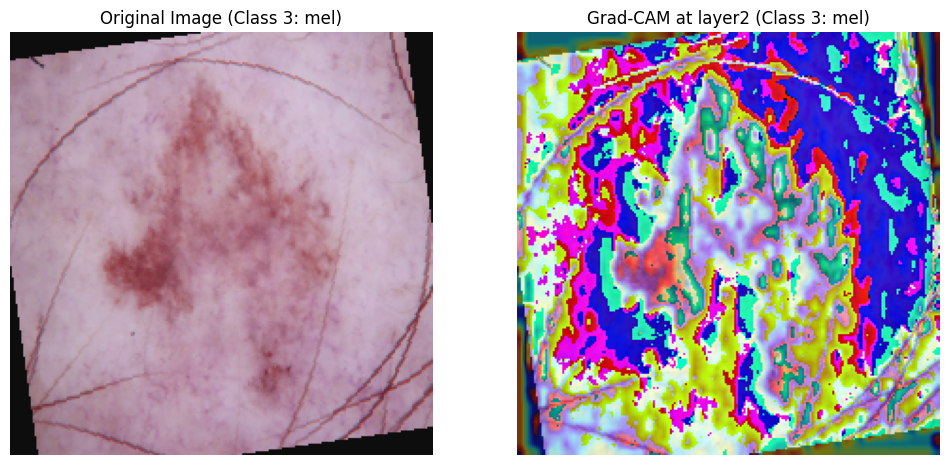


Class 4 - vasc


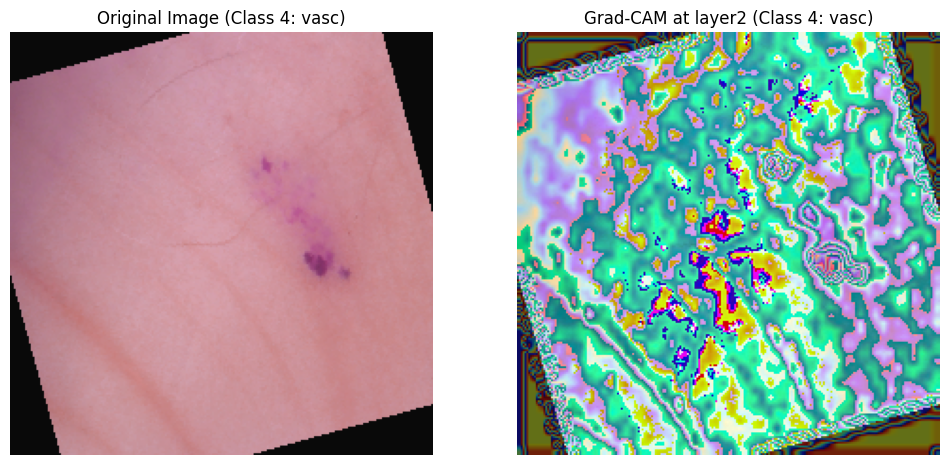

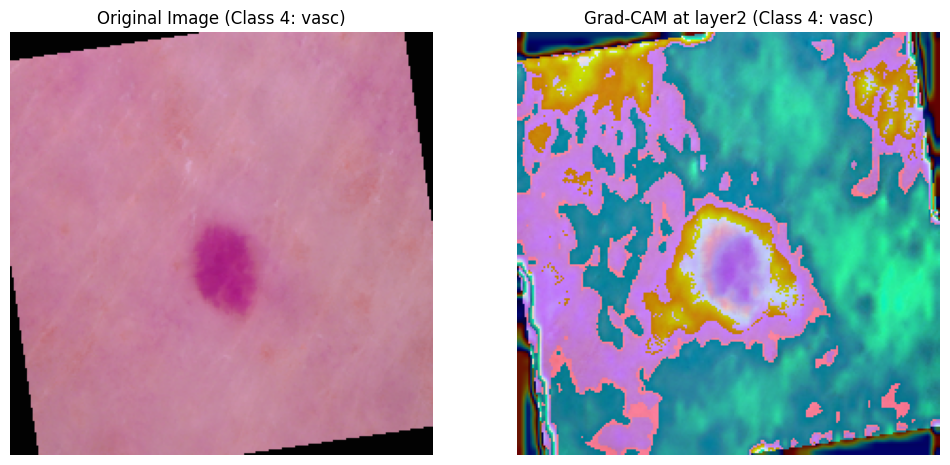


Class 5 - bcc


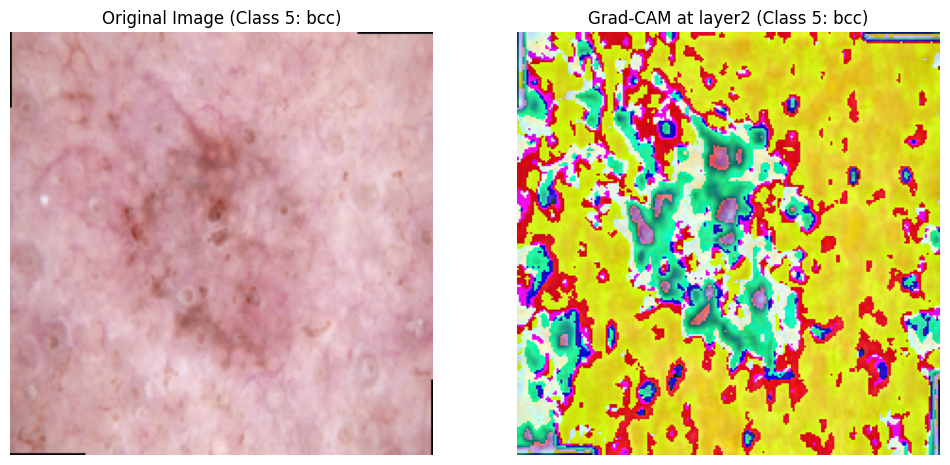

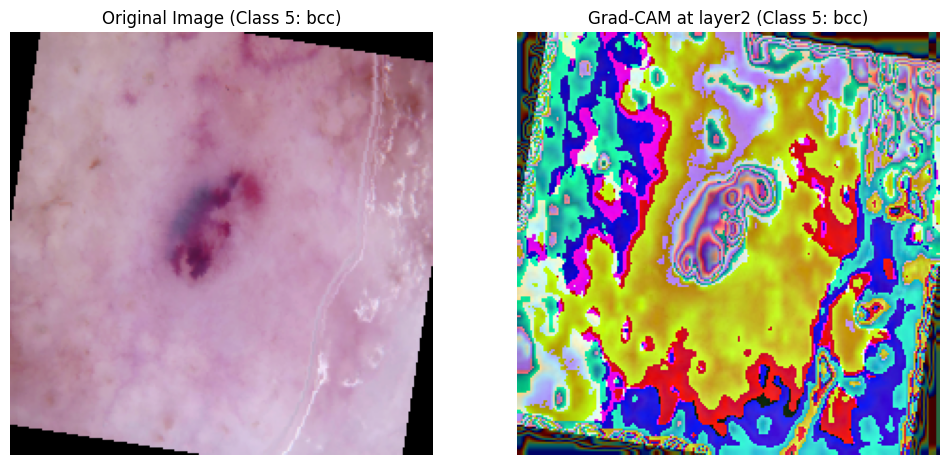


Class 6 - akiec


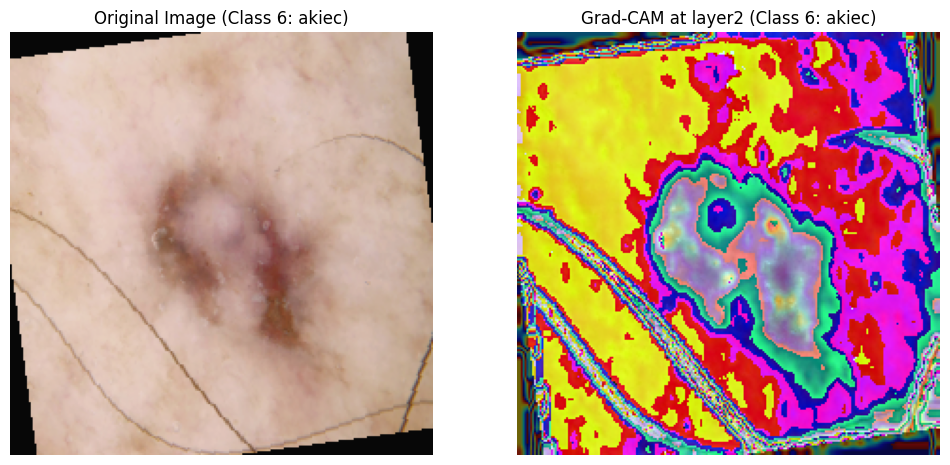

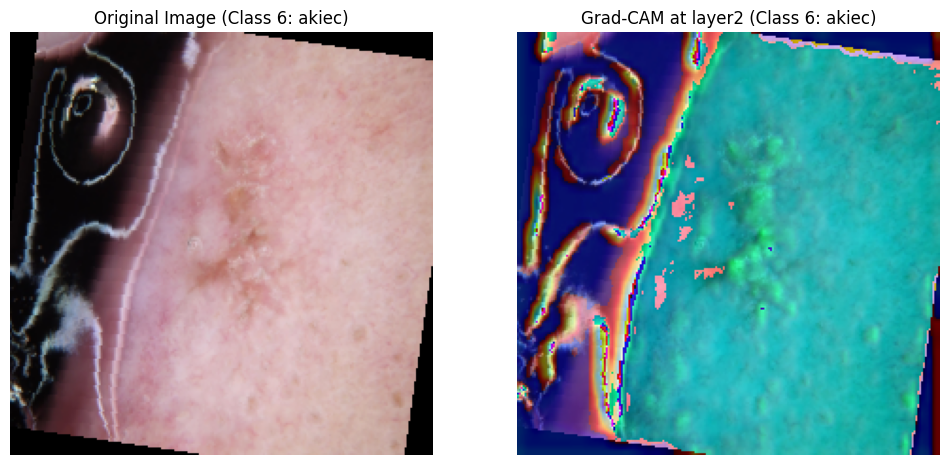

In [65]:
# Loop through each class and apply Grad-CAM on 2 random images at intermediate layer
for target_class in range(7):
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if len(target_images) >= 2:
        selected_images = random.sample(target_images, 2)
        class_name = index_to_class[target_class]
        
        print(f"\nClass {target_class} - {class_name}")
        
        for image in selected_images:
            heatmap = grad_cam_layer(CNN_model, image, target_class, "layer2")
            display_grad_cam_layer(image.squeeze(0), heatmap, "layer2", target_class, class_name)
